In [1]:
import scipy.io
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import seaborn as sns
import glob
import os
import scvi
import anndata as ad

In [2]:
adatas = []
adatas = [sc.read(f) for f in glob.glob(os.path.join(r"GSE157827_RAW/clean_data", "*_quality_control.h5"))]
adata = ad.concat(adatas, label="sample")
adata.obs_names_make_unique()

In [425]:
total = 0
doublets_removed = 0
for adata in adatas:
    print(len(adata), adata.uns['doublets_removed'])
    total += len(adata)
    doublets_removed += adata.uns['doublets_removed']

print(total)
print(doublets_removed)
print(doublets_removed*100/total)

9360 724.0
376 0.0
1692 113.0
2391 75.0
4178 200.0
3376 411.0
6934 446.0
2317 199.0
4416 454.0
261 0.0
926 98.0
3982 221.0
928 32.0
8602 757.0
6196 489.0
3376 530.0
1777 18.0
6971 684.0
5391 496.0
2867 72.0
3059 408.0
79376
6427.0
8.096905865752872


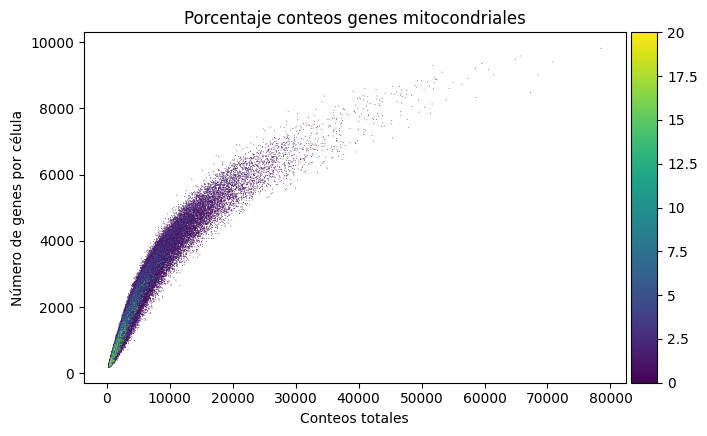

In [50]:
ax = sc.pl.scatter(
    adata,
    "total_counts",
    "n_genes_by_counts",
    color="pct_counts_mt",
    title="Porcentaje conteos genes mitocondriales",
    show=False
)

ax.set_xlabel("Conteos totales")
ax.set_ylabel("Número de genes por célula")

plt.show()

In [3]:
sc.pp.filter_genes(adata, min_cells = 50)

In [33]:
adata

AnnData object with n_obs × n_vars = 79376 × 23712
    obs: 'Patient', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_mt', 'pct_counts_ribo', 'pct_counts_hb', 'outlier', 'mt_outlier', 'doublet', 'doublet_score', 'sample'
    var: 'n_cells'

In [5]:
adata.raw = adata
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=3000, 
    subset=True,
    batch_key='Patient',
    flavor='seurat_v3',
    span=0.5
)

In [ ]:
from sklearn.metrics import silhouette_score
import gc

scvi.model.SCVI.setup_anndata(
    adata, 
    categorical_covariate_keys=['Patient'], 
    continuous_covariate_keys=['pct_counts_mt', 'pct_counts_ribo']
)


sc.tl.pca(adata)

idx_sub = np.random.choice(adata.n_obs, size=min(10000, adata.n_obs), replace=False)
X_pca_sub = adata.obsm['X_pca'][idx_sub]
batch_labels_sub = adata.obs['Patient'].iloc[idx_sub]

sil_before = silhouette_score(X_pca_sub, batch_labels_sub)


param_grid = [
    {'n_layers': 2, 'n_latent': 10, 'gene_likelihood': 'nb', 'dropout_rate': 0.1},
    {'n_layers': 2, 'n_latent': 50, 'gene_likelihood': 'nb', 'dropout_rate': 0.1},
    {'n_layers': 2, 'n_latent': 30, 'gene_likelihood': 'zinb', 'dropout_rate': 0.1},
    {'n_layers': 3, 'n_latent': 50, 'gene_likelihood': 'zinb', 'dropout_rate': 0.1},
    {'n_layers': 2, 'n_latent': 30, 'gene_likelihood': 'poisson', 'dropout_rate': 0.1},
]

results = []

for i, params in enumerate(param_grid):
    print(f"\n--- Entrenando Modelo {i+1}/10 ---")
    print(params)
    
    model = scvi.model.SCVI(
        adata, 
        n_layers=params['n_layers'],
        n_latent=params['n_latent'],
        gene_likelihood=params['gene_likelihood'],
        dropout_rate=params['dropout_rate']
    )
    
    model.train(max_epochs=150, early_stopping=True, early_stopping_patience=5)
    
    latent_key = f'X_scvi_model_{i+1}'
    adata.obsm[latent_key] = model.get_latent_representation()
    
    elbo = model.history['elbo_train'].iloc[-1].item()
    
    X_scvi_sub = adata.obsm[latent_key][idx_sub]
    sil_batch = silhouette_score(X_scvi_sub, batch_labels_sub)
    
    res = params.copy()
    res['Model_ID'] = i+1
    res['ELBO_Loss'] = elbo
    res['Silhouette_Batch'] = sil_batch
    results.append(res)
    
    del model
    gc.collect()

results_df = pd.DataFrame(results)

results_df['Improvement_vs_Baseline'] = sil_before - results_df['Silhouette_Batch']
results_df = results_df.sort_values(by='Silhouette_Batch', ascending=True)

best_model_idx = results_df.iloc[0]['Model_ID']
adata.obsm['X_scvi'] = adata.obsm[f'X_scvi_model_{best_model_idx}']


--- Entrenando Modelo 1/10 ---
{'n_layers': 2, 'n_latent': 10, 'gene_likelihood': 'nb', 'dropout_rate': 0.1}


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/150 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 5 records. Best score: 811.893. Signaling Trainer to stop.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



--- Entrenando Modelo 2/10 ---
{'n_layers': 2, 'n_latent': 50, 'gene_likelihood': 'nb', 'dropout_rate': 0.1}


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/150 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=150` reached.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



--- Entrenando Modelo 3/10 ---
{'n_layers': 2, 'n_latent': 30, 'gene_likelihood': 'zinb', 'dropout_rate': 0.1}


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/150 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=150` reached.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



--- Entrenando Modelo 4/10 ---
{'n_layers': 3, 'n_latent': 50, 'gene_likelihood': 'zinb', 'dropout_rate': 0.1}


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/150 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 5 records. Best score: 800.510. Signaling Trainer to stop.


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



--- Entrenando Modelo 5/10 ---
{'n_layers': 2, 'n_latent': 30, 'gene_likelihood': 'poisson', 'dropout_rate': 0.1}


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/150 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=150` reached.


In [36]:
results_df

,n_layers,n_latent,gene_likelihood,dropout_rate,Model_ID,ELBO_Loss,Silhouette_Batch,Improvement_vs_Baseline
0,2,10,nb,0.1,1,810.712952,-0.135677,-0.209668
1,2,50,nb,0.1,2,809.281128,-0.112616,-0.232729
4,2,30,poisson,0.1,5,847.387024,-0.110026,-0.235318
3,3,50,zinb,0.1,4,798.719604,-0.101549,-0.243795
2,2,30,zinb,0.1,3,801.452515,-0.097075,-0.248269


In [40]:
model = scvi.model.SCVI(adata, n_layers=3, n_latent=50, gene_likelihood="zinb", dropout_rate=0.1)
model.train(max_epochs= 150, early_stopping=True, early_stopping_patience=5)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/150 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 5 records. Best score: 794.969. Signaling Trainer to stop.


In [41]:
model.save(r"GSE157827_RAW/clean_data/CPF_Integration_global_model/model.pt")

In [6]:
model = scvi.model.SCVI.load(r"GSE157827_RAW\clean_data\CPF_Integration_global_model\model.pt", adata = adata)

INFO     File GSE157827_RAW\clean_data\CPF_Integration_global_model\model.pt\model.pt already downloaded           


In [6]:
y = model.history['reconstruction_loss_validation']['reconstruction_loss_validation'].min()

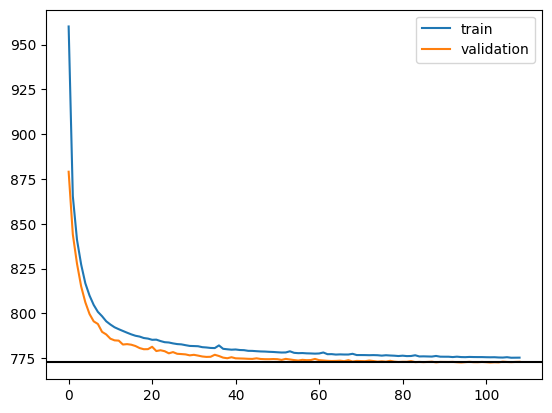

In [7]:
plt.plot(model.history['reconstruction_loss_train']['reconstruction_loss_train'], label = 'train')
plt.plot(model.history['reconstruction_loss_validation']['reconstruction_loss_validation'], label = 'validation')
plt.axhline(y, c = 'k')

plt.legend()
plt.show()

In [7]:
adata.obsm['X_scVI'] = model.get_latent_representation()

In [8]:
sc.pp.neighbors(adata, use_rep = 'X_scVI')

In [9]:
sc.tl.leiden(adata, resolution = 1, key_added = 'overcluster')

C:\Users\User\AppData\Local\Temp\ipykernel_15088\2777784826.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution = 1, key_added = 'overcluster')


In [10]:
adata.layers['counts'] = adata.X.copy()

In [11]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [12]:
sc.tl.umap(adata)

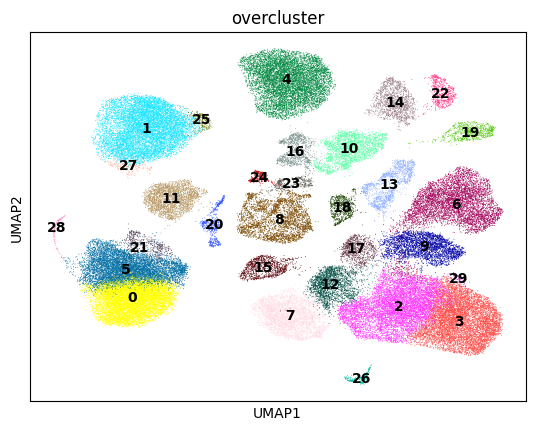

In [13]:
sc.pl.umap(adata, color=["overcluster"], legend_loc="on data")

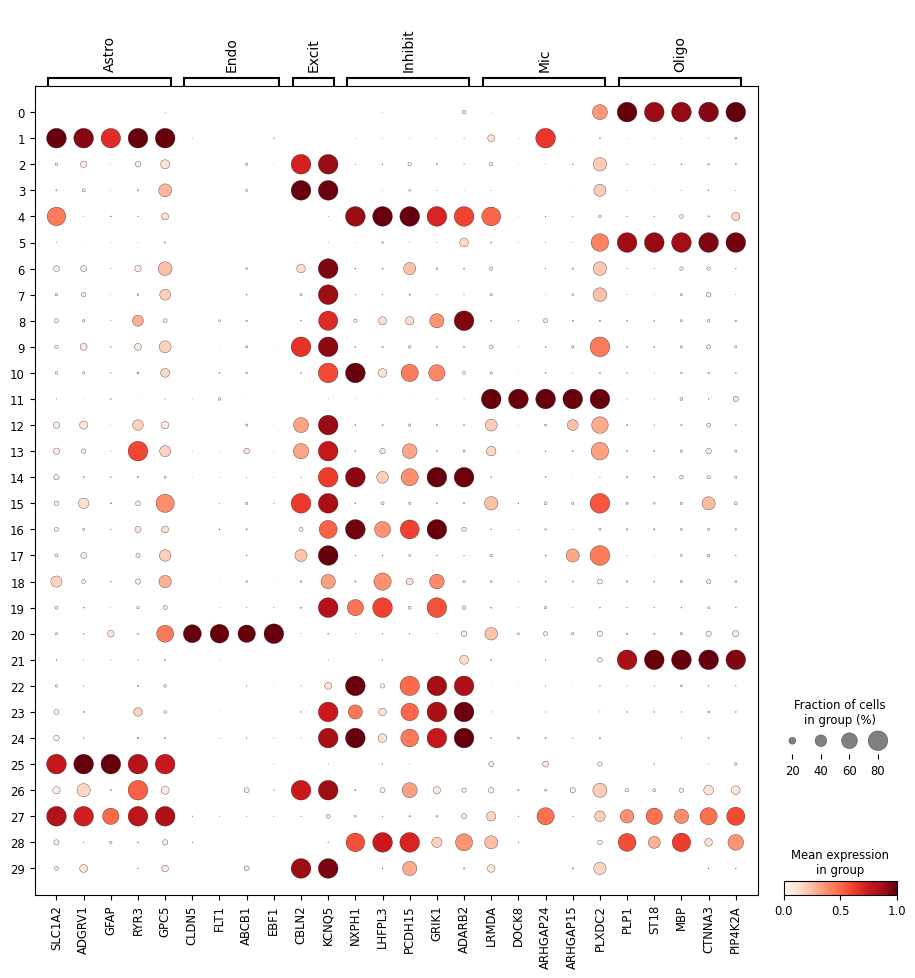

In [ ]:
marker_genes = {
    "Astro": ["SLC1A2", "ADGRV1", "GFAP","RYR3","GPC5"],
    "Endo": ["CLDN5", "FLT1", "ABCB1","EBF1"],
    "Excit": ["RALYL", "CBLN2", "KCNIP4","LDB2","KCNQ5"],
    "Inhibit": ["NXPH1","LHFPL3","PCDH15","GRIK1","ADARB2"],
    "Mic": ["LRMDA","DOCK8","ARHGAP24","ARHGAP15","PLXDC2"],
    "Oligo": ["PLP1", "ST18", "MBP","CTNNA3","PIP4K2A"],
}

marker_genes_present = {
    ct: [g for g in genes if g in adata.var_names]
    for ct, genes in marker_genes.items()
}

sc.pl.dotplot(
    adata,
    marker_genes_present,
    groupby="overcluster",
    standard_scale="var",
    dot_max=0.8,
    use_raw=False
)

In [56]:
sc.tl.rank_genes_groups(adata, groupby = 'overcluster', method = 'wilcoxon', use_raw = False)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:456: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\tools\_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\tools\_rank_gene

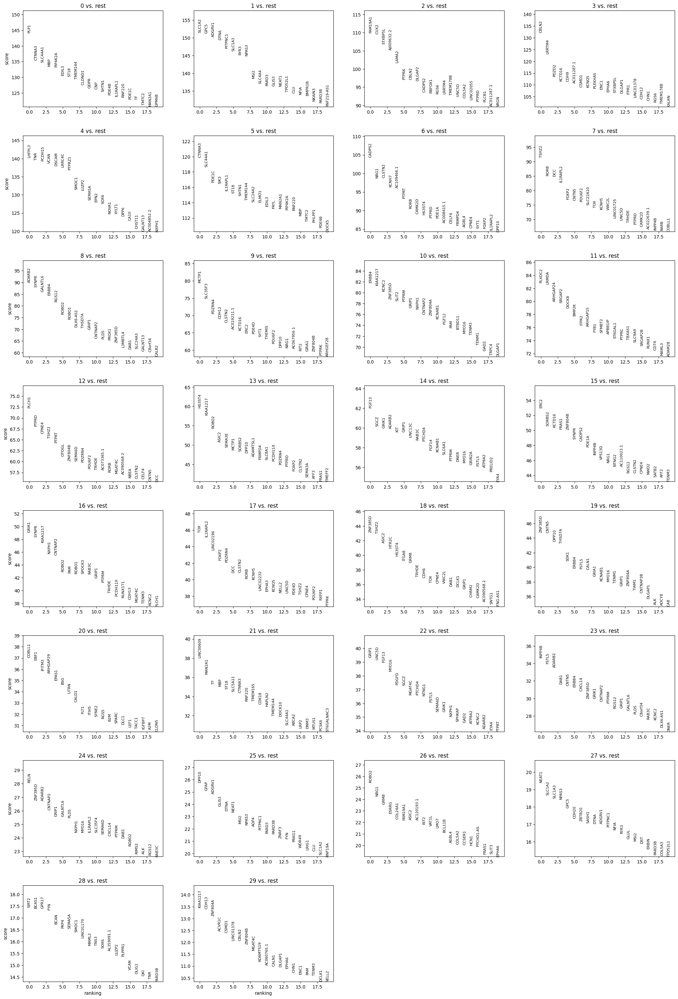

In [58]:
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False)

In [59]:
marks = sc.get.rank_genes_groups_df(adata, group = None)

In [14]:
annotation_map = {
    '2': 'Excit','3': 'Excit','6': 'Excit','7': 'Excit','9': 'Excit','12': 'Excit','13': 'Excit','15': 'Excit','17': 'Excit','26': 'Excit','29': 'Excit',
    '4': 'Inhibit','8': 'Inhibit','10': 'Inhibit','14': 'Inhibit','16': 'Inhibit','22': 'Inhibit','23': 'Inhibit','24': 'Inhibit',
    '1': 'Astro', '25': 'Astro', '27': 'Astro',
    '0': 'Oligo','5': 'Oligo','21': 'Oligo','28': 'Oligo',
    '11': 'Mic',
    '20': 'Endo',
    '18': 'Other','19': 'Other'
}

adata.obs['cell_type'] = adata.obs['overcluster'].map(annotation_map)
print("Conteo de células por tipo celular anotado:")
print(adata.obs['cell_type'].value_counts())
adata.obs['cell_type'] = adata.obs['cell_type'].astype('category')

Conteo de células por tipo celular anotado:
cell_type
Excit      32253
Oligo      16917
Inhibit    16562
Astro       9231
Mic         2412
Other       1383
Endo         618
Name: count, dtype: int64


In [75]:
sc.tl.rank_genes_groups(adata, groupby='cell_type', method='wilcoxon',use_raw=False)

In [76]:
top_genes_nombres = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(3)

print(top_genes_nombres)

    Astro    Endo  Excit Inhibit       Mic    Oligo    Other
0  SLC1A2  COBLL1  KALRN   GRIK1    PLXDC2   CTNNA3  ZNF385D
1    GPC5    EBF1  NELL2   NXPH1     LRMDA  SLC44A1    DPP10
2  ADGRV1  IFITM3   CHN1   ERBB4  ARHGAP24     PLP1    GRIP1


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\tools\_dendrogram.py:138: UserWarning: You’re trying to run this on 3000 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  _choose_representation(adata, use_rep=use_rep, n_pcs=n_pcs)


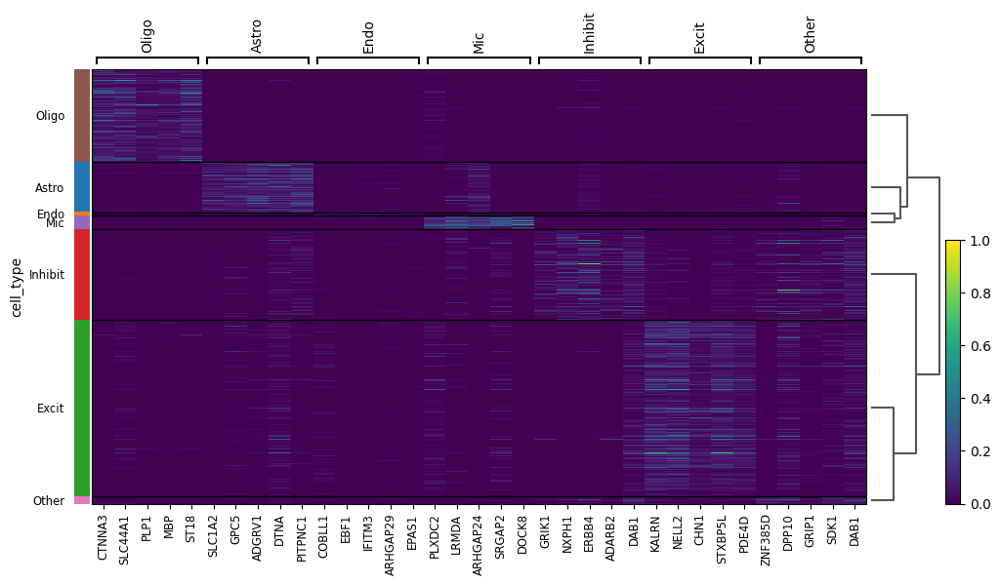

In [66]:
sc.pl.rank_genes_groups_heatmap(
    adata, 
    n_genes=5, 
    groupby='cell_type', 
    show_gene_labels=True,
    standard_scale='var',
    cmap='viridis' 
)

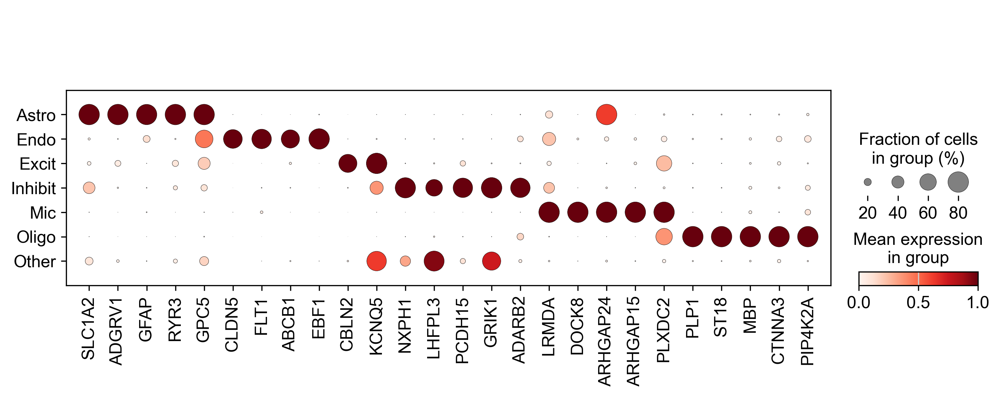

In [89]:
sc.settings.set_figure_params(
    dpi=150,
    fontsize=14
)

sc.pl.dotplot(
    adata,
    var_names=[
        'SLC1A2', 'ADGRV1', 'GFAP', 'RYR3', 'GPC5',
        'CLDN5', 'FLT1', 'ABCB1', 'EBF1',
        'CBLN2', 'KCNQ5', 'NXPH1',
        'LHFPL3', 'PCDH15', 'GRIK1', 'ADARB2',
        'LRMDA', 'DOCK8', 'ARHGAP24', 'ARHGAP15',
        'PLXDC2', 'PLP1', 'ST18', 'MBP',
        'CTNNA3', 'PIP4K2A'
    ],
    groupby="cell_type",
    standard_scale="var",
    dot_max=0.8,
    use_raw=False
)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\anndata\_core\anndata.py:1175: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\anndata\_core\anndata.py:1175: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


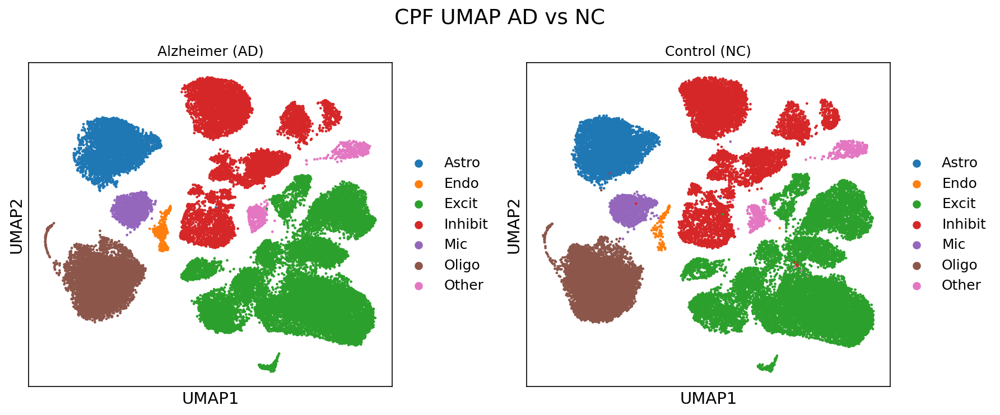

In [ ]:
adata.obs['Condition'] = adata.obs['Patient'].str[:2]
fig, axs = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(adata[adata.obs['Condition'] == 'AD'],color='cell_type',title='Alzheimer (AD)',ax=axs[0],show=False)
sc.pl.umap(adata[adata.obs['Condition'] == 'NC'],color='cell_type',title='Control (NC)',ax=axs[1],show=False)
fig.suptitle('CPF UMAP AD vs NC', fontsize=16)
plt.tight_layout()
plt.show()

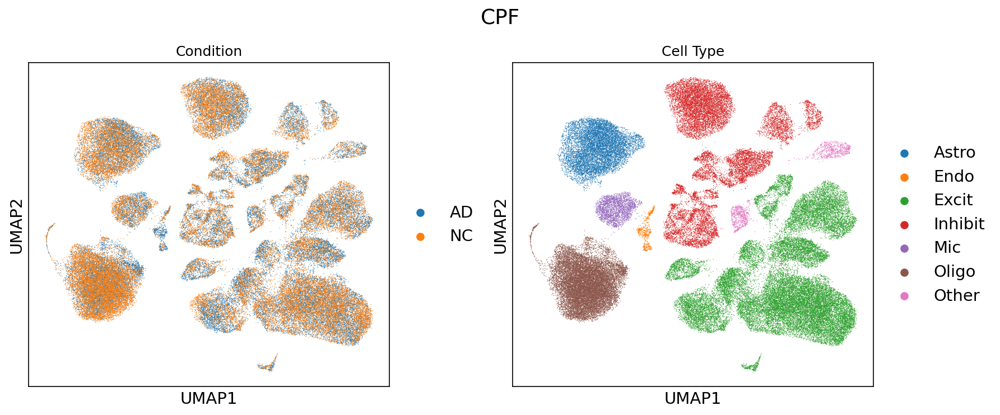

In [87]:
import matplotlib.pyplot as plt
import scanpy as sc

# Mejorar calidad de la figura
plt.rcParams['figure.dpi'] = 150
plt.rcParams['savefig.dpi'] = 300

fig, axs = plt.subplots(1, 2, figsize=(12, 5))

sc.pl.umap(
    adata,
    color='Condition',
    title='Condition',
    ax=axs[0],
    show=False,
    legend_fontsize=14
)

sc.pl.umap(
    adata,
    color='cell_type',
    title='Cell Type',
    ax=axs[1],
    show=False,
    legend_fontsize=14
)

# Ajustar ejes y ticks
for ax in axs:
    ax.set_xlabel('UMAP1', fontsize=14)
    ax.set_ylabel('UMAP2', fontsize=14)
    ax.tick_params(axis='both', labelsize=14)

fig.suptitle('CPF', fontsize=18)
plt.tight_layout()
plt.show()


<>:25: SyntaxWarning: invalid escape sequence '\p'
<>:25: SyntaxWarning: invalid escape sequence '\p'
C:\Users\User\AppData\Local\Temp\ipykernel_24520\1670803430.py:25: SyntaxWarning: invalid escape sequence '\p'
  'Proporción de Núcleos por Tipo Celular (Media $\pm$ SEM)',
C:\Users\User\AppData\Local\Temp\ipykernel_24520\1670803430.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_counts = adata.obs.groupby(['Patient', 'Condition', 'cell_type']).size().reset_index(name='N')
C:\Users\User\AppData\Local\Temp\ipykernel_24520\1670803430.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  patient_total_

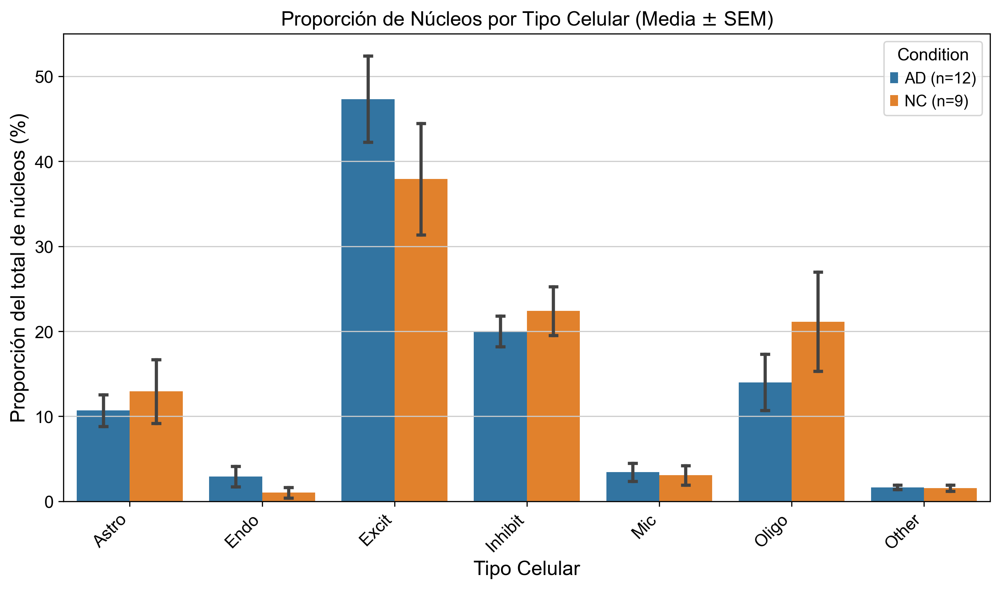

In [92]:
patient_counts = adata.obs.groupby(['Patient', 'Condition', 'cell_type']).size().reset_index(name='N')

patient_total_N = adata.obs.groupby(['Patient', 'Condition']).size().reset_index(name='Total_N')

proportions_per_patient = pd.merge(patient_counts, patient_total_N, on=['Patient', 'Condition'])
proportions_per_patient['Proportion'] = (proportions_per_patient['N'] / proportions_per_patient['Total_N']) * 100

proportions_per_patient['Condition'] = proportions_per_patient['Condition'].replace({
    'AD': 'AD (n=12)', 
    'NC': 'NC (n=9)'
})

plt.figure(figsize=(10, 6))

sns.barplot(
    data=proportions_per_patient,
    x='cell_type',
    y='Proportion',
    hue='Condition',
    errorbar='se',
    capsize=0.1
)

plt.title(
    'Proporción de Núcleos por Tipo Celular (Media $\pm$ SEM)',
    fontsize=14
)
plt.ylabel('Proporción del total de núcleos (%)', fontsize=14)
plt.xlabel('Tipo Celular', fontsize=14)

plt.xticks(rotation=45, ha='right', fontsize=12)
plt.yticks(fontsize=12)

plt.legend(title='Condition', title_fontsize=12, fontsize=11)

plt.tight_layout()
plt.show()

In [ ]:

summary_stats = proportions_per_patient.groupby(['Condition', 'cell_type'])['Proportion'].agg(['mean', 'sem']).reset_index()

summary_stats.columns = ['Condition', 'cell_type', 'Average_Percentage', 'Error_Bar_SEM']

summary_stats['Average_Percentage'] = summary_stats['Average_Percentage'].round(2)
summary_stats['Error_Bar_SEM'] = summary_stats['Error_Bar_SEM'].round(2)

print(summary_stats)


    Condition cell_type  Average_Percentage  Error_Bar_SEM
0   AD (n=12)     Astro               10.68           1.86
1   AD (n=12)      Endo                2.92           1.21
2   AD (n=12)     Excit               47.32           5.07
3   AD (n=12)   Inhibit               19.99           1.81
4   AD (n=12)       Mic                3.43           1.06
5   AD (n=12)     Oligo               14.00           3.31
6   AD (n=12)     Other                1.66           0.25
7    NC (n=9)     Astro               12.93           3.75
8    NC (n=9)      Endo                1.03           0.62
9    NC (n=9)     Excit               37.91           6.55
10   NC (n=9)   Inhibit               22.39           2.88
11   NC (n=9)       Mic                3.06           1.13
12   NC (n=9)     Oligo               21.13           5.83
13   NC (n=9)     Other                1.55           0.37


C:\Users\User\AppData\Local\Temp\ipykernel_24520\1866980850.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  summary_stats = proportions_per_patient.groupby(['Condition', 'cell_type'])['Proportion'].agg(['mean', 'sem']).reset_index()


# Estadística con scCoda

In [19]:
import pandas as pd
import sccoda.util.cell_composition_data as dat
import sccoda.util.comp_ana as mod

counts_df = pd.crosstab(adata.obs['Patient'], adata.obs['cell_type'])
counts_df = counts_df.reset_index()

meta_df = adata.obs[['Patient', 'Condition']].drop_duplicates()

counts_df['Patient'] = counts_df['Patient'].astype(str)
meta_df['Patient'] = meta_df['Patient'].astype(str)

data_merged = pd.merge(counts_df, meta_df, on='Patient', how='left')

data_merged = data_merged.set_index('Patient')

print(data_merged.head())

data_sccoda = dat.from_pandas(
    data_merged,
    covariate_columns=["Condition"]
)

model = mod.CompositionalAnalysis(
    data_sccoda,
    formula="Condition",
    reference_cell_type="Oligo" 
)

my_results = model.sample_hmc()
my_results.summary()




         Astro  Endo  Excit  Inhibit  Mic  Oligo  Other Condition
Patient                                                          
AD1        200    18    786      732  262    341     52        AD
AD2       1205     0   1320     1243  262   2815     89        AD
AD4        237    91    912      344  181    505     47        AD
AD5        203     1   2809      815    1    430    157        AD
AD6         12    16    192       37    0      3      1        AD
Zero counts encountered in data! Added a pseudocount of 0.5.


100%|██████████| 20000/20000 [01:01<00:00, 327.61it/s]


MCMC sampling finished. (78.309 sec)
Acceptance rate: 57.3%
Compositional Analysis summary:

Data: 21 samples, 7 cell types
Reference index: 5
Formula: Condition

Intercepts:
           Final Parameter  Expected Sample
Cell Type                                  
Astro                0.317       426.797544
Endo                -1.052       108.560733
Excit                1.650      1618.588520
Inhibit              0.988       834.898169
Mic                 -0.783       142.068561
Oligo                0.468       496.364117
Other               -0.711       152.674738


Effects:
                           Final Parameter  Expected Sample  log2-fold change
Covariate       Cell Type                                                    
Condition[T.NC] Astro                  0.0       426.797544               0.0
                Endo                   0.0       108.560733               0.0
                Excit                  0.0      1618.588520               0.0
                Inhibit     

In [141]:
deg_results = {}
cell_types = adata.obs['cell_type'].unique()

for ct in cell_types:
    print(f"Calculando DEGs para: {ct}...")
    
    adata_subset = adata[adata.obs['cell_type'] == ct].copy()

    sc.tl.rank_genes_groups(adata_subset, groupby='Condition', reference='NC', method='wilcoxon', use_raw = False)
    
    df_results = sc.get.rank_genes_groups_df(adata_subset, group='AD')

    df_results = df_results[df_results['pvals_adj'] < 0.05]
    df_results = df_results[(df_results['logfoldchanges'] >= 0.25) | 
                            (df_results['logfoldchanges'] <= -0.25)]

    deg_results[ct] = df_results


Calculando DEGs para: Excit...
Calculando DEGs para: Inhibit...
Calculando DEGs para: Other...
Calculando DEGs para: Mic...
Calculando DEGs para: Astro...
Calculando DEGs para: Oligo...
Calculando DEGs para: Endo...


In [142]:
rows = []

for ct, df in deg_results.items():
    n_up   = (df['logfoldchanges'] >= 0.05).sum()
    n_down = (df['logfoldchanges'] <= -0.05).sum()

    rows.append({
        'cell_type': ct,
        'Up': n_up,
        'Down': n_down
    })

df_table = pd.DataFrame(rows).set_index('cell_type')
orden = ["Excit", "Inhibit", "Mic", "Astro", "Oligo", "Endo", "Other"]
df_table = df_table.reindex(orden)
df_table.columns = pd.MultiIndex.from_product([['AD vs NC (CPF)'], df_table.columns])
df_table_renamed = df_table.rename_axis('Tipo de célula')

df_table_renamed

AD vs NC (CPF)     
                           Up Down
Tipo de célula                    
Excit                      54  579
Inhibit                    41  440
Mic                        64   88
Astro                      99  282
Oligo                     118  203
Endo                      413   30
Other                       8   42

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\upsetplot\data.py:385: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.fillna(False, inplace=True)
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\upsetplot\plotting.py:795: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.

<Figure size 3600x1800 with 0 Axes>

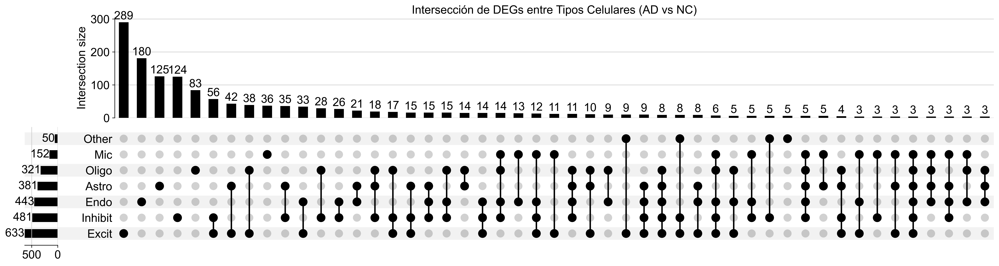

In [ ]:
import matplotlib.pyplot as plt
from upsetplot import from_contents, UpSet

gene_sets = {}
plt.rcParams.update({
    'font.size': 16,
    'axes.labelsize': 16,
    'xtick.labelsize': 16,
    'ytick.labelsize': 16,
    'axes.titlesize': 16,
    'figure.dpi': 300
})
for cell_type, df in deg_results.items():
    sig_genes = df[
        (df['pvals_adj'] < 0.05) & 
        (abs(df['logfoldchanges']) > 0.25)
    ]['names'].tolist()
    
    gene_sets[cell_type] = sig_genes

upset_data = from_contents(gene_sets)

plt.figure(figsize=(12, 6))
upset = UpSet(upset_data, subset_size='count', show_counts=True, sort_by='cardinality', min_subset_size = 3)
upset.plot()

plt.title("Intersección de DEGs entre Tipos Celulares (AD vs NC)")
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

plt.rcParams.update({'font.size': 12}) 

LOG_FOLD_CHANGE = 0.25
P_VALUE_THRESHOLD = 0.01

def volcano_plot_custom(deg_results, cell_type, title=None):
    df = deg_results[cell_type].copy()

    df["pvals_adj"] = df["pvals_adj"].astype(float)
    df["-logQ"] = -np.log10(df["pvals_adj"] + 1e-300)

    condition_significant = (abs(df["logfoldchanges"]) > LOG_FOLD_CHANGE) & \
                            (df["pvals_adj"] < P_VALUE_THRESHOLD)

    lowqval_de = df.loc[condition_significant]
    other_de = df.loc[~condition_significant]

    fig, ax = plt.subplots(figsize=(8, 6))

    sns.regplot(
        x=other_de["logfoldchanges"],
        y=other_de["-logQ"],
        fit_reg=False,
        scatter_kws={"s": 10, "color": "grey", "alpha": 0.5},
        ax=ax
    )

    sns.regplot(
        x=lowqval_de["logfoldchanges"],
        y=lowqval_de["-logQ"],
        fit_reg=False,
        scatter_kws={"s": 20, "color": "red", "alpha": 0.8},
        ax=ax
    )

    ax.set_xlabel("log2 Fold Change", fontsize=20)
    ax.set_ylabel("-log10 (adj P-value)", fontsize=20)
    ax.tick_params(axis='both', which='major', labelsize=20)

    ax.axvline(LOG_FOLD_CHANGE, color='k', ls='--', lw=0.8)
    ax.axvline(-LOG_FOLD_CHANGE, color='k', ls='--', lw=0.8)

    y_pos = -np.log10(P_VALUE_THRESHOLD)
    ax.axhline(y_pos, color='k', ls='--', lw=0.8)
    ax.set_xlim(-10, 10)
    if title is None:
        title = f"CPF: DEGs {cell_type} (AD vs NC)"
    plt.title(title, fontsize=16)
    
    sns.despine()
    plt.show()

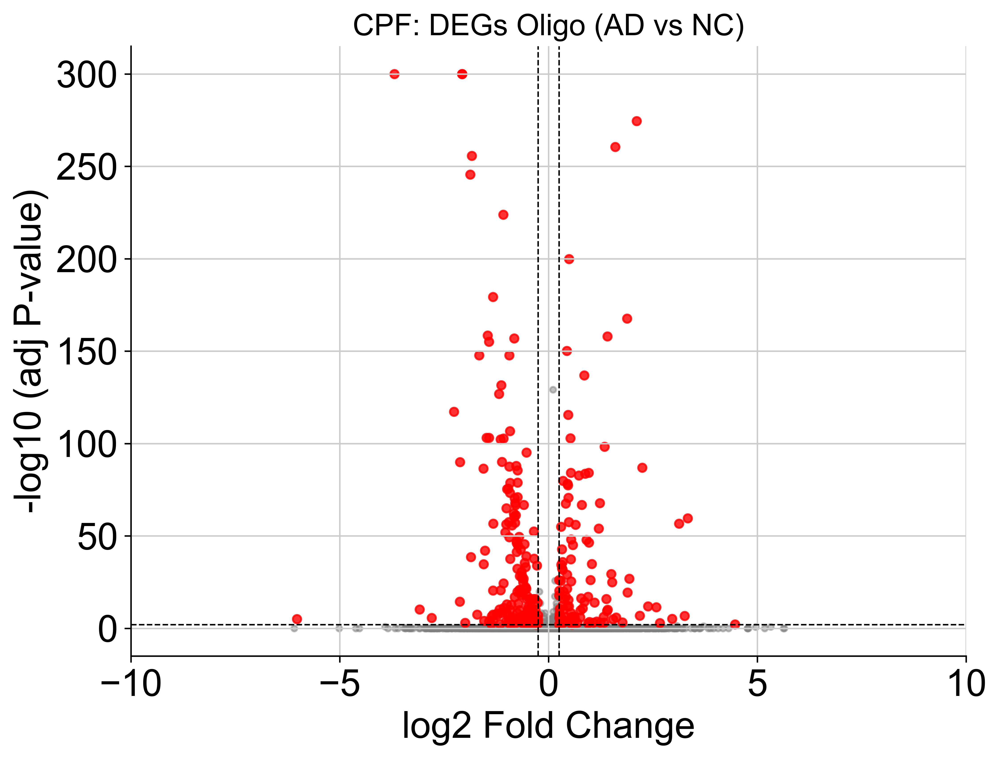

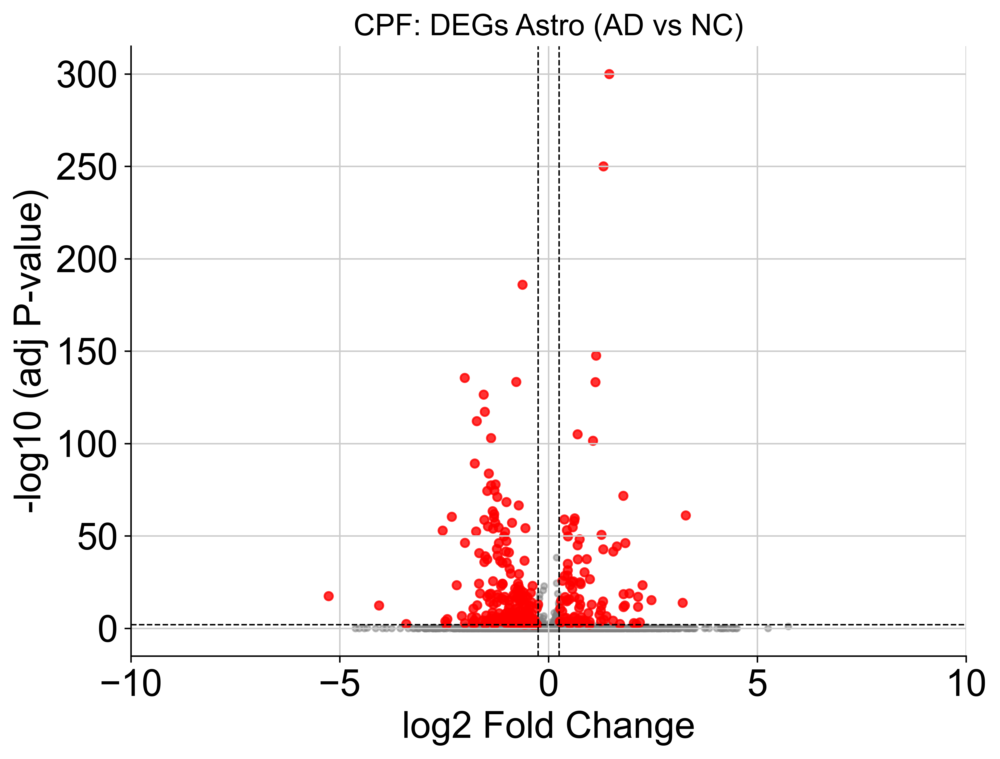

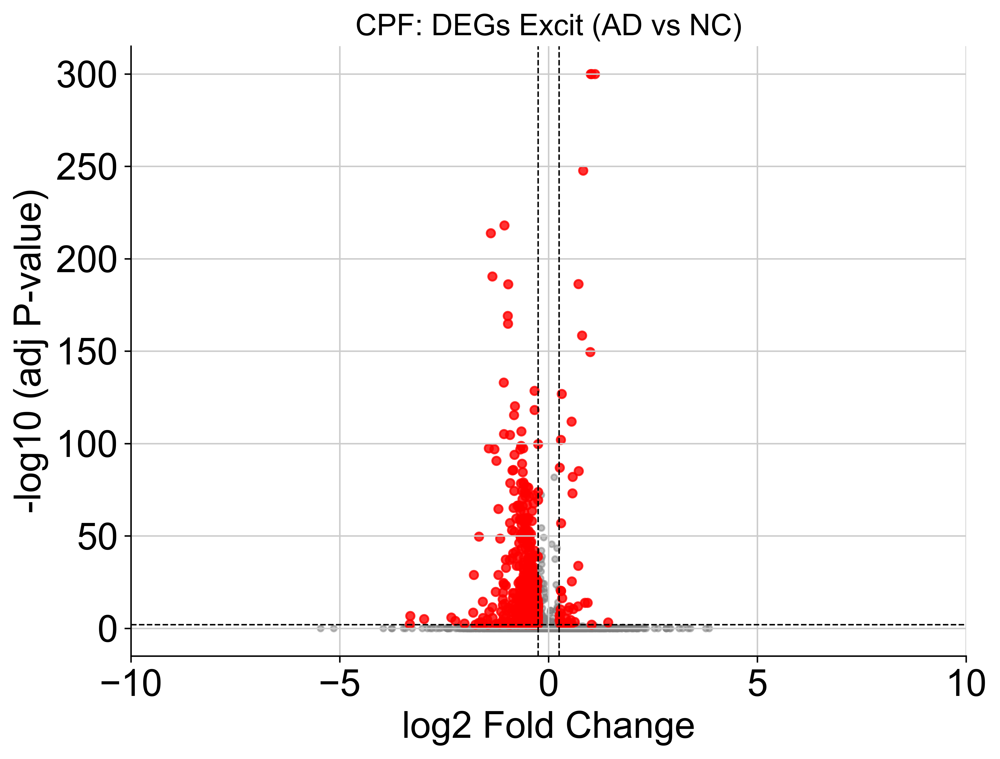

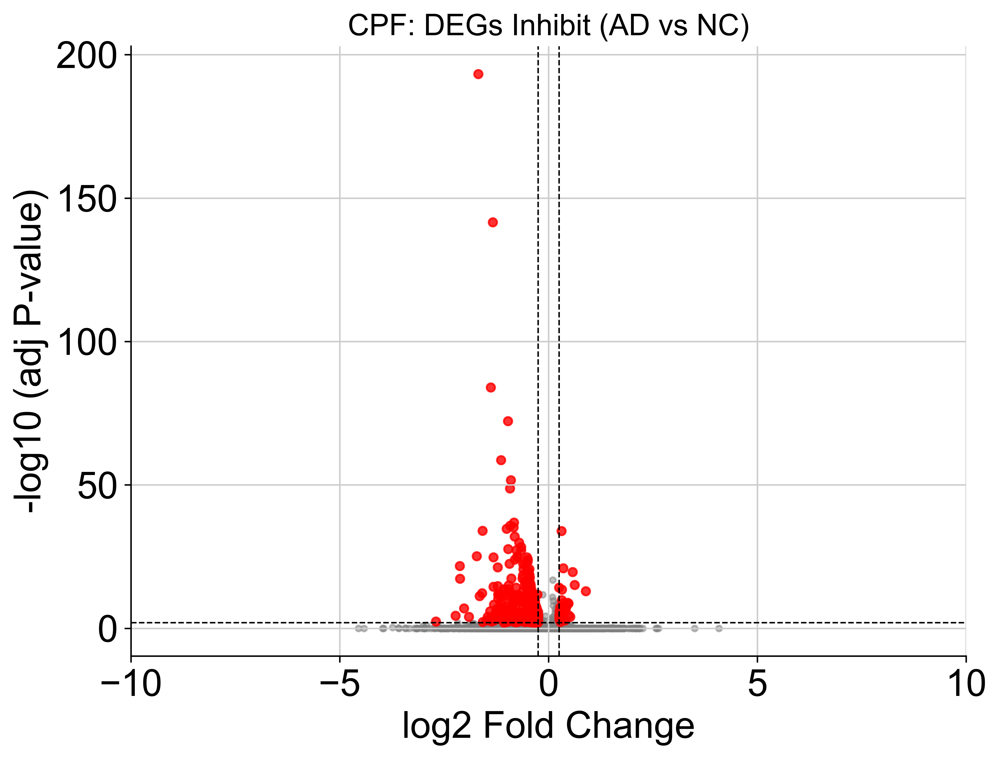

In [140]:
volcano_plot_custom(deg_results, "Oligo")
volcano_plot_custom(deg_results, "Astro")
volcano_plot_custom(deg_results, "Excit")
volcano_plot_custom(deg_results, "Inhibit")

C:\Users\User\AppData\Local\Temp\ipykernel_24520\3063696431.py:50: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  plt.gca().set_xticklabels([str(abs(int(x))) for x in vals])


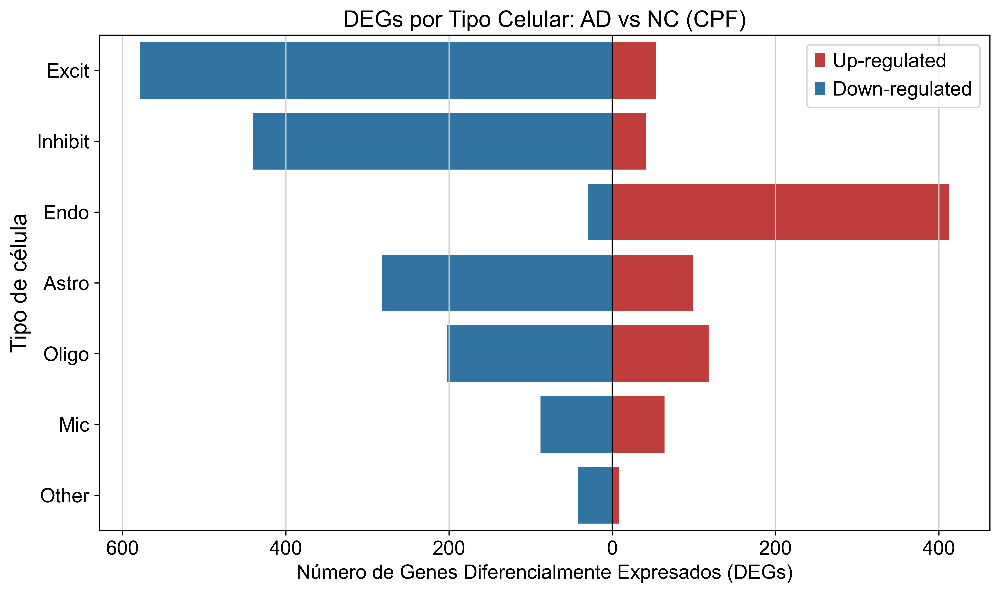

In [143]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

plot_data = df_table_renamed.copy()
plot_data.columns = ['Up', 'Down']
plot_data = plot_data.reset_index()

plot_data['Down_neg'] = plot_data['Down'] * -1

plot_data['Total'] = plot_data['Up'] + plot_data['Down']
plot_data = plot_data.sort_values('Total', ascending=False)

plt.figure(figsize=(10, 6))

sns.barplot(
    data=plot_data,
    x='Up',
    y='Tipo de célula',
    color='#d62728',
    label='Up-regulated'
)

sns.barplot(
    data=plot_data,
    x='Down_neg',
    y='Tipo de célula',
    color='#1f77b4',
    label='Down-regulated'
)

plt.axvline(0, color='black', linewidth=1)

plt.xlabel(
    'Número de Genes Diferencialmente Expresados (DEGs)',
    fontsize=14
)
plt.title(
    'DEGs por Tipo Celular: AD vs NC (CPF)',
    fontsize=16
)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.legend(fontsize=14, title_fontsize=14)

# Mostrar valores positivos en el eje X
vals = plt.gca().get_xticks()
plt.gca().set_xticklabels([str(abs(int(x))) for x in vals])

plt.tight_layout()
plt.show()

Total de genes seleccionados para el mapa: 1679


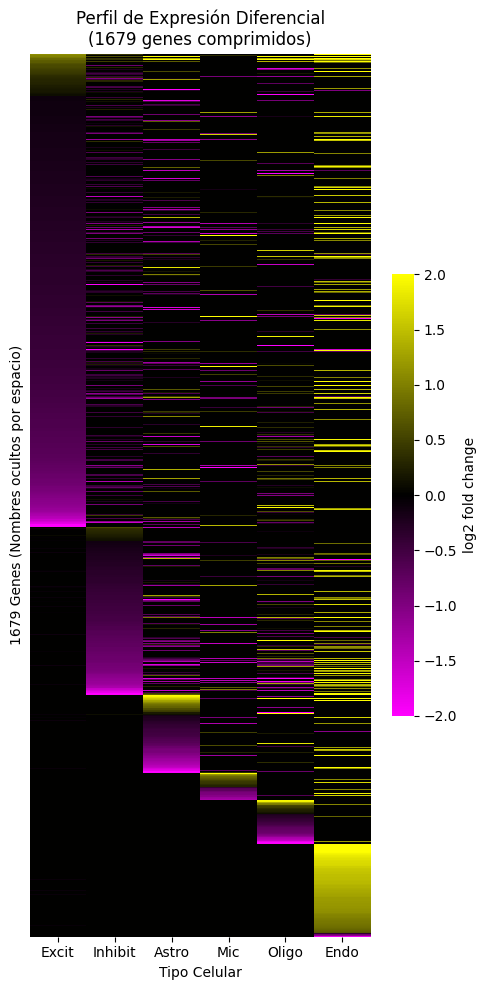

In [ ]:
p_val_thresh = 0.1
log2fc_thresh = 0.1

desired_order = ['Excit', 'Inhibit', 'Astro', 'Mic', 'Oligo', 'Endo']
desired_order = [ct for ct in desired_order if ct in deg_results.keys()]

sorted_genes = []
genes_seen = set()

for ct in desired_order:
    df = deg_results[ct]
    mask = (df['pvals_adj'] < p_val_thresh) & (df['logfoldchanges'].abs() > log2fc_thresh)
    df_sig = df[mask].copy()
    
    if df_sig.empty: continue
    
    df_sig = df_sig.sort_values('logfoldchanges', ascending=False)
    
    for gene in df_sig['names']:
        if gene not in genes_seen:
            sorted_genes.append(gene)
            genes_seen.add(gene)

print(f"Total de genes seleccionados para el mapa: {len(sorted_genes)}")

lfc_matrix_dynamic = pd.DataFrame(index=sorted_genes, columns=desired_order)
for ct in desired_order:
    df_temp = deg_results[ct].set_index('names')
    lfc_matrix_dynamic[ct] = df_temp['logfoldchanges'].reindex(sorted_genes)
lfc_matrix_dynamic = lfc_matrix_dynamic.fillna(0)

plt.figure(figsize=(5, 10))

custom_cmap = sns.blend_palette(["magenta", "black", "yellow"], as_cmap=True)

sns.heatmap(
    lfc_matrix_dynamic,
    cmap=custom_cmap,
    center=0,
    vmin=-2,
    vmax=2,
    xticklabels=True,
    yticklabels=False,
    cbar_kws={'label': 'log2 fold change', 'shrink': 0.5},
    linewidths=0.0,
    rasterized=True
)

plt.title(f"Perfil de Expresión Diferencial\n({len(sorted_genes)} genes comprimidos)")
plt.xlabel("Tipo Celular")
plt.ylabel(f"{len(sorted_genes)} Genes (Nombres ocultos por espacio)")
plt.tight_layout()
plt.show()

# Hyperparameter tuning csvi models

In [19]:
adatas = []
adatas = [sc.read(f) for f in glob.glob(os.path.join(r"GSE157827_RAW/clean_data", "*_normalization.h5"))]
adata = ad.concat(adatas, label="sample")
adata.obs_names_make_unique()
sc.pp.highly_variable_genes(adata, n_top_genes=3000, batch_key="sample", layer='log1p_norm', subset=True)

In [ ]:
import scvi
import os
import pandas as pd

param_grid = [
    {
        'name': '1_Equilibrado_NB',
        'n_layers': 2, 'n_latent': 30, 'n_hidden': 128, 
        'gene_likelihood': 'nb', 'dispersion': 'gene'
    },
    {
        'name': '2_CorrectorLotes_LN',
        'n_layers': 2, 'n_latent': 30, 'n_hidden': 128, 
        'gene_likelihood': 'nb', 'dispersion': 'gene-batch', 
        'latent_distribution': 'ln'
    },
    {
        'name': '3_ModeloCeros_ZINB',
        'n_layers': 2, 'n_latent': 30, 'n_hidden': 128, 
        'gene_likelihood': 'zinb', 'dispersion': 'gene'
    },
    {
        'name': '4_RedProfunda_Regularizada',
        'n_layers': 3, 'n_latent': 50, 'n_hidden': 256, 
        'gene_likelihood': 'nb', 'dropout_rate': 0.2
    }
]

base_save_dir = "./scvi_models_creative/"
os.makedirs(base_save_dir, exist_ok=True)

results_list = []

print(f"Iniciando entrenamiento de {len(param_grid)} modelos/filosofías...")

for param_set in param_grid:
    model_name = param_set['name']
    save_path = os.path.join(base_save_dir, model_name)
    
    print(f"\n--- Entrenando modelo: {model_name} ---")
    
    params_to_pass = param_set.copy()
    del params_to_pass['name']
    
    print("Parámetros:")
    for key, val in params_to_pass.items():
        print(f"  {key}: {val}")

    scvi.model.SCVI.setup_anndata(adata, batch_key="sample", layer='log1p_norm')
    model = scvi.model.SCVI(
        adata,
        **params_to_pass 
    )
    
    model.train(
        validation_size=0.1,
        early_stopping=True,
        early_stopping_patience=10
    )
    
    model.save(save_path, overwrite=True)

    best_val_loss = min(model.history['validation_loss'].reset_index()['validation_loss'])
    results_list.append({
        'model_name': model_name,
        'validation_loss': best_val_loss,
        'save_path': save_path
    })
    
    print(f"Modelo {model_name} guardado. Loss: {best_val_loss:.4f}")

print("\n--- Entrenamiento completado ---")

results_df = pd.DataFrame(results_list)
results_df = results_df.sort_values(by='validation_loss', ascending=True)

print("\n=== Resultados (Ordenados por Validation Loss) ===")
print(results_df)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Iniciando entrenamiento de 4 modelos/filosofías...

--- Entrenando modelo: 1_Equilibrado_NB ---
Parámetros:
  n_layers: 2
  n_latent: 30
  n_hidden: 128
  gene_likelihood: nb
  dispersion: gene


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/102 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=102` reached.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Modelo 1_Equilibrado_NB guardado. Loss: 584.1208

--- Entrenando modelo: 2_CorrectorLotes_LN ---
Parámetros:
  n_layers: 2
  n_latent: 30
  n_hidden: 128
  gene_likelihood: nb
  dispersion: gene-batch
  latent_distribution: ln


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/102 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=102` reached.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Modelo 2_CorrectorLotes_LN guardado. Loss: 588.7556

--- Entrenando modelo: 3_ModeloCeros_ZINB ---
Parámetros:
  n_layers: 2
  n_latent: 30
  n_hidden: 128
  gene_likelihood: zinb
  dispersion: gene


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/102 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=102` reached.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Modelo 3_ModeloCeros_ZINB guardado. Loss: 583.2277

--- Entrenando modelo: 4_RedProfunda_Regularizada ---
Parámetros:
  n_layers: 3
  n_latent: 50
  n_hidden: 256
  gene_likelihood: nb
  dropout_rate: 0.2


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\lightning\pytorch\trainer\connectors\data_connector.py:433: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=11` in the `DataLoader` to improve performance.


Training:   0%|          | 0/102 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=102` reached.


Modelo 4_RedProfunda_Regularizada guardado. Loss: 589.0297

--- Entrenamiento completado ---

=== Resultados (Ordenados por Validation Loss) ===
                   model_name  validation_loss  \
2          3_ModeloCeros_ZINB       583.227661   
0            1_Equilibrado_NB       584.120850   
1         2_CorrectorLotes_LN       588.755615   
3  4_RedProfunda_Regularizada       589.029663   

                                           save_path  
2          ./scvi_models_creative/3_ModeloCeros_ZINB  
0            ./scvi_models_creative/1_Equilibrado_NB  
1         ./scvi_models_creative/2_CorrectorLotes_LN  
3  ./scvi_models_creative/4_RedProfunda_Regularizada  


# Subcluster analysis Oligo CON INTEGRACION HARMONY

In [ ]:
oligo_barcodes = adata.obs[adata.obs['cell_type'] == 'Oligo'].index
adata_full = adata.raw.to_adata()
adata_oligo = adata_full[oligo_barcodes].copy()
adata_oligo.obs = adata.obs.loc[oligo_barcodes].copy()

In [ ]:
adata_oligo.raw = adata_oligo 

sc.pp.highly_variable_genes(
    adata_oligo, 
    n_top_genes=2000, 
    batch_key="Patient",
    subset=False
)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:309: RuntimeWarning: invalid value encountered in log
  dispersion = np.log(dispersion)
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:693: UserWarning: `n_top_genes` > number of normalized dispersions, returning all genes with normalized dispersions.
  df = _highly_variable_genes_batched(


In [ ]:
import scanpy.external as sce
adata_oligo = adata_oligo[:, adata_oligo.var['highly_variable']].copy()

sc.pp.scale(adata_oligo, max_value=10)

sc.tl.pca(adata_oligo)

print("Ejecutando Harmony...")
sce.pp.harmony_integrate(adata_oligo, key='Patient', max_iter_harmony=20)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\functools.py:929: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)
2025-12-03 21:05:45,224 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...


Ejecutando Harmony...


2025-12-03 21:05:46,941 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-12-03 21:05:47,031 - harmonypy - INFO - Iteration 1 of 20
2025-12-03 21:05:50,895 - harmonypy - INFO - Iteration 2 of 20
2025-12-03 21:05:54,817 - harmonypy - INFO - Iteration 3 of 20
2025-12-03 21:05:58,635 - harmonypy - INFO - Converged after 3 iterations


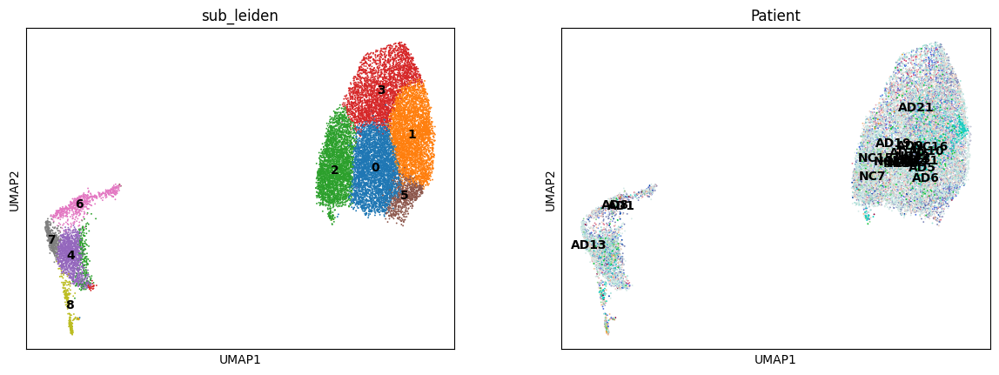

In [ ]:
sc.pp.neighbors(adata_oligo, use_rep='X_pca_harmony', n_neighbors=50) 

sc.tl.leiden(adata_oligo, resolution=1, key_added='sub_leiden')


sc.tl.umap(adata_oligo)

# PLOT
sc.pl.umap(adata_oligo, color=["sub_leiden", "Patient"], legend_loc="on data")

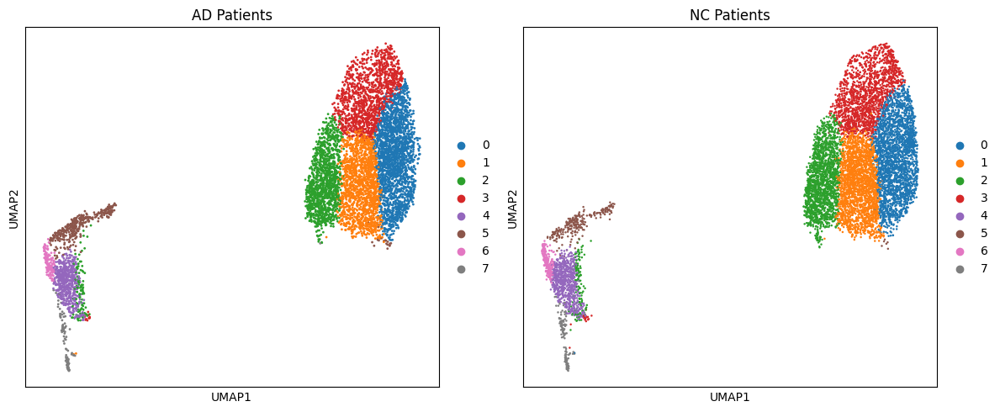

In [ ]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

sc.pl.umap(
    adata_oligo[adata_oligo.obs['Patient'].str.startswith("AD")].copy(),
    color="sub_leiden",
    ax=axes[0],
    show=False,
    title="AD Patients"
)

sc.pl.umap(
    adata_oligo[adata_oligo.obs['Patient'].str.startswith("NC")].copy(),
    color="sub_leiden",
    ax=axes[1],
    show=False,
    title="NC Patients"
)

plt.tight_layout()
plt.show()


# Subcluster analysis Oligo SIN INTEGRACION

In [178]:
adata_oligo = adata[adata.obs['cell_type'] == 'Oligo'].copy()
print(f"Número de células en el objeto original: {adata.n_obs}")
print(f"Número de células en el nuevo objeto 'Astro': {adata_oligo.n_obs}")

Número de células en el objeto original: 79376
Número de células en el nuevo objeto 'Astro': 16917


c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\functools.py:929: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


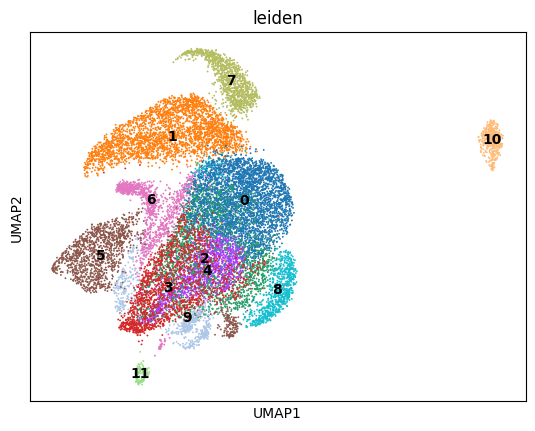

In [ ]:

adata_oligo.X = adata_oligo.layers['counts'].copy()

adata_oligo.raw = adata_oligo

sc.pp.highly_variable_genes(adata_oligo, flavor='seurat', n_top_genes=2000)
adata_oligo = adata_oligo[:, adata_oligo.var['highly_variable']].copy()

sc.pp.scale(adata_oligo, max_value=10)
sc.tl.pca(adata_oligo)

sc.pp.neighbors(adata_oligo)
sc.tl.leiden(adata_oligo, resolution=0.5)
sc.tl.umap(adata_oligo)

sc.pl.umap(adata_oligo, color=["leiden"], legend_loc="on data")


# Subcluster analysis OLIGO CON ITNEGRACION SCVI

In [ ]:
import scvi
import scanpy as sc

oligo_barcodes = adata.obs[adata.obs['cell_type'] == 'Oligo'].index
adata_full = adata.raw.to_adata()
adata_oligo = adata_full[oligo_barcodes].copy()
adata_oligo.obs = adata.obs.loc[oligo_barcodes].copy()

sc.pp.highly_variable_genes(
    adata_oligo, 
    flavor="seurat_v3", 
    n_top_genes=2000, 
    subset=False
)


adata_subset_oligo = adata_oligo[:, adata_oligo.var['highly_variable']].copy()

scvi.model.SCVI.setup_anndata(
    adata_subset_oligo, 
    categorical_covariate_keys=['Patient'], 
    continuous_covariate_keys=['pct_counts_mt', 'pct_counts_ribo']
)

model = scvi.model.SCVI(adata_subset_oligo, n_layers=2, n_latent=30, gene_likelihood="nb")
model.train(max_epochs=200, early_stopping=True, early_stopping_patience = 5)

adata_oligo.obsm['X_scVI'] = model.get_latent_representation()

sc.pp.normalize_total(adata_oligo)
sc.pp.log1p(adata_oligo)

adata_oligo.raw = adata_oligo 

sc.pp.neighbors(adata_oligo, use_rep='X_scVI')
sc.tl.umap(adata_oligo)

sc.tl.leiden(adata_oligo, resolution=0.3)

sc.pl.umap(adata_oligo, color=["leiden", "Patient"])

In [ ]:
sc.pp.neighbors(adata_oligo, use_rep='X_scVI')
sc.tl.umap(adata_oligo)

sc.tl.leiden(adata_oligo, resolution=0.6)

sc.pl.umap(adata_oligo, color=["leiden", "Patient"])

In [151]:
clusters = sorted(adata_oligo.obs['leiden'].unique(), key=int)
cluster_map = {cl: f"o{int(cl)+1}" for cl in clusters}

adata_oligo.obs['Ocluster'] = adata_oligo.obs['leiden'].map(cluster_map)

In [148]:
sc.tl.leiden(adata_oligo, resolution=0.9, key_added='leiden')
clusters = sorted(adata_oligo.obs['leiden'].unique(), key=int)
cluster_map = {cl: f"o{int(cl)+1}" for cl in clusters}

adata_oligo.obs['Ocluster'] = adata_oligo.obs['leiden'].map(cluster_map)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\plotting\_utils.py:482: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\plotting\_utils.py:482: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


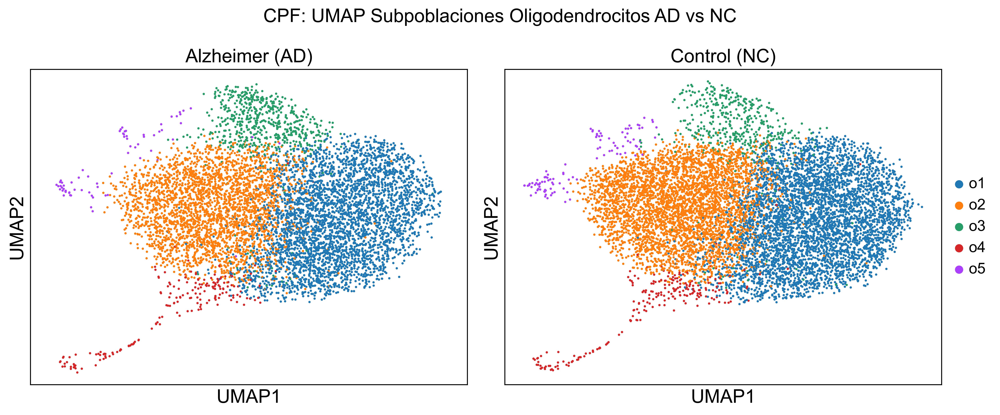

In [152]:
import matplotlib.pyplot as plt
umap_coords = adata_oligo.obsm['X_umap']
x_min, x_max = umap_coords[:, 0].min(), umap_coords[:, 0].max()
y_min, y_max = umap_coords[:, 1].min(), umap_coords[:, 1].max()
pad = 0.5 

fig, axs = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(adata_oligo[adata_oligo.obs['Condition'] == 'AD'], 
           color='Ocluster', title='Alzheimer (AD)', 
           ax=axs[0], show=False, size=15, legend_loc=None)
sc.pl.umap(adata_oligo[adata_oligo.obs['Condition'] == 'NC'], 
           color='Ocluster', title='Control (NC)', 
           ax=axs[1], show=False, size=15)
for ax in axs:
    ax.set_xlim(x_min - pad, x_max + pad)
    ax.set_ylim(y_min - pad, y_max + pad)

fig.suptitle('CPF: UMAP Subpoblaciones Oligodendrocitos AD vs NC', fontsize=16)
plt.tight_layout()
plt.show()

# Up y downregulations + GO Analisis Oligodendrocitos

In [153]:
adata_oligo.obs['Condition'] = adata_oligo.obs['Patient'].str[:2]

In [154]:
import pandas as pd

ct = adata_oligo.obs.groupby(["Ocluster", "Condition"]).size().unstack(fill_value=0)

ct["prop_AD"] = ct["AD"] / ct["AD"].sum()
ct["prop_NC"] = ct["NC"] / ct["NC"].sum()

ct["delta"] = (ct["prop_AD"] - ct["prop_NC"]) * 100
ct


C:\Users\User\AppData\Local\Temp\ipykernel_24520\1003978972.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ct = adata_oligo.obs.groupby(["Ocluster", "Condition"]).size().unstack(fill_value=0)


Condition,AD,NC,prop_AD,prop_NC,delta
Ocluster,,,,,
o1,3744,4690,0.501339,0.496349,0.499023
o2,2827,3963,0.378548,0.419409,-4.086099
o3,636,460,0.085163,0.048682,3.648096
o4,192,231,0.025710,0.024447,0.126266
o5,69,105,0.009239,0.011112,-0.187287


In [155]:
ct_sorted = ct.sort_values("delta", ascending=False)

In [ ]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(5, 4))

x = range(len(ct_sorted))

ax.bar(x, ct_sorted["delta"])

ax.set_xticks(x)
ax.set_xticklabels(ct_sorted.index, rotation=45)

ax.axhline(0, color="black", linewidth=1)

ax.set_ylabel("AD vs NC\nCambios en la proporción (%)")
ax.set_title("CPF: Oligo")

plt.tight_layout()
plt.show()


Firma UP: 698 genes | Firma DOWN: 796 genes


C:\Users\User\AppData\Local\Temp\ipykernel_24520\3302606402.py:37: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_means = df_expr.groupby(cluster_col).mean()


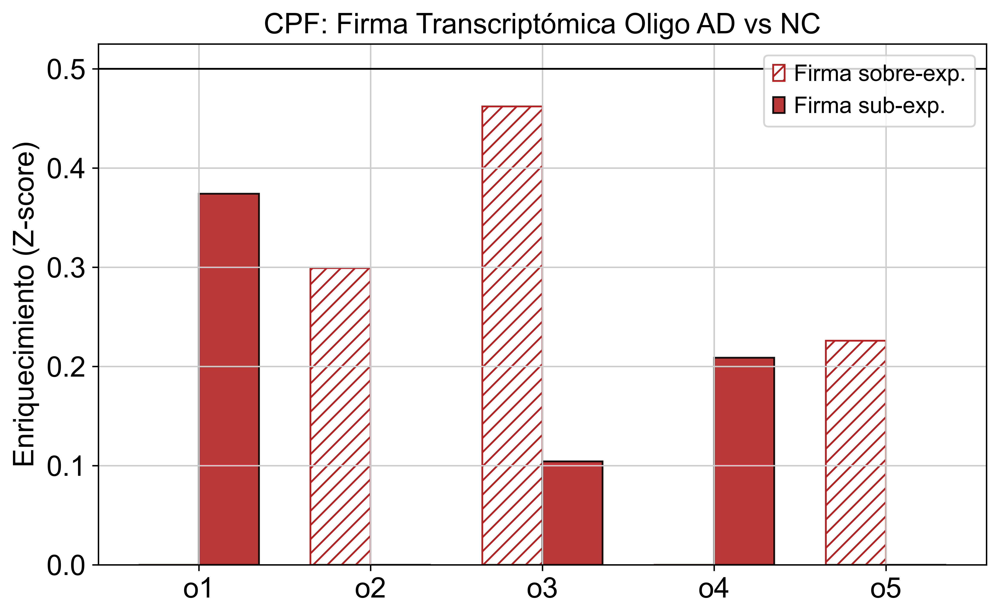

In [171]:
from scipy.stats import zscore

sc.tl.rank_genes_groups(
    adata_oligo,
    groupby='Condition',
    method='wilcoxon',
    use_raw=True,
    pts=True,
    key_added='rank_genes_AD_vs_NC'
)

res_global = sc.get.rank_genes_groups_df(adata_oligo, group='AD', key='rank_genes_AD_vs_NC')

up_signature = res_global[(res_global['pvals_adj'] < 0.1) & (res_global['logfoldchanges'] > 0.1)]['names'].tolist()
down_signature = res_global[(res_global['pvals_adj'] < 0.1) & (res_global['logfoldchanges'] < -0.1)]['names'].tolist()

print(f"Firma UP: {len(up_signature)} genes | Firma DOWN: {len(down_signature)} genes")

cluster_col = 'Ocluster'

genes_of_interest = list(set(up_signature + down_signature))

genes_of_interest = [g for g in genes_of_interest if g in adata_oligo.var_names]

data_subset = adata_oligo[:, genes_of_interest].X

if scipy.sparse.issparse(data_subset):
    data_subset = data_subset.toarray()
    
df_expr = pd.DataFrame(
    data_subset,
    index=adata_oligo.obs_names,
    columns=genes_of_interest
)
df_expr[cluster_col] = adata_oligo.obs[cluster_col].values

cluster_means = df_expr.groupby(cluster_col).mean()

z_matrix = cluster_means.apply(zscore, axis=0).fillna(0)

enrichment_scores = pd.DataFrame(index=cluster_means.index)

valid_up = [g for g in up_signature if g in z_matrix.columns]
valid_down = [g for g in down_signature if g in z_matrix.columns]

enrichment_scores['Firma sobreexp.'] = z_matrix[valid_up].mean(axis=1)
enrichment_scores['Firma subexp.'] = z_matrix[valid_down].mean(axis=1)* -1

fig, ax = plt.subplots(figsize=(8, 5))
x = np.arange(len(enrichment_scores))
width = 0.35

up_values = enrichment_scores['Firma sobreexp.'].clip(lower=0)
down_values = enrichment_scores['Firma subexp.'].clip(lower=0)

ax.bar(x - width/2, up_values, width, label='Firma sobre-exp.', color='white', edgecolor='firebrick', hatch='///')
ax.bar(x + width/2, down_values, width, label='Firma sub-exp.', color='firebrick', edgecolor='black', alpha=0.9)

ax.axhline(y=0.5, color='black', linewidth=1)
ax.set_ylabel('Enriquecimiento (Z-score)')
ax.set_xticks(x)
ax.set_xticklabels(enrichment_scores.index)
ax.legend(loc = 'upper right')
ax.set_title('CPF: Firma Transcriptómica Oligo AD vs NC')

plt.tight_layout()
plt.show()

In [ ]:
cluster_map = {
    'o1': 'Stable',
    'o2': 'Stable',
    'o3': 'Stable',
    'o4': 'Stable',
    'o5': 'Stable',
    'o6': 'Stable' ,
    'o7': 'Stable',
}
adata_oligo.obs['subpop_status'] = adata_oligo.obs['Ocluster'].map(cluster_map)
adata_oligo.obs['subpop_status'] = adata_oligo.obs['subpop_status'].fillna('Other')
print(adata_oligo.obs['subpop_status'].value_counts())

sc.tl.rank_genes_groups(adata_oligo, groupby='subpop_status', method='wilcoxon', pts=True, use_raw=True)
dedf = sc.get.rank_genes_groups_df(adata_oligo, group='Downregulated')
genes_significativos = dedf[
    (dedf['pvals_adj'] < 0.1) & 
    (dedf['logfoldchanges'] > 0.1)
].sort_values('logfoldchanges', ascending=False)

print(f"Genes encontrados: {len(genes_significativos)}")

subpop_status
Stable           9391
Downregulated    7526
Name: count, dtype: int64
Genes encontrados: 329


In [ ]:
genes_significativos = dedf[
    (dedf['pvals_adj'] < 0.05) & 
    (dedf['logfoldchanges'] > 0.25)
].sort_values('logfoldchanges', ascending=False)

print(f"Genes encontrados: {len(genes_significativos)}")
print(genes_significativos[['names', 'logfoldchanges', 'pvals_adj']].head(10))

Genes encontrados: 955
        names  logfoldchanges     pvals_adj
240  PRICKLE1       27.351086  6.184739e-07
450     PRRX1       26.631376  4.261888e-04
594    ZNF469       25.776070  3.445167e-03
255    ADAM33       14.877049  1.689344e-06
515  MIR9-3HG       11.802985  1.273753e-03
692     FIBIN       11.715034  8.767446e-03
104     BMPER       11.573269  4.709758e-13
299     C1QL1       11.540216  1.092121e-05
794    PLPPR5       11.487138  2.079506e-02
115    BRINP1       11.244792  3.544762e-12


In [144]:

print(genes_significativos[['names', 'logfoldchanges', 'pvals_adj']].head(10))


lista_para_GO = genes_significativos['names'].tolist()

print(f"Tienes {len(lista_para_GO)} genes para analizar.")
print("Copia estos genes:")
print('\n'.join(lista_para_GO))

NameError: name 'genes_significativos' is not defined

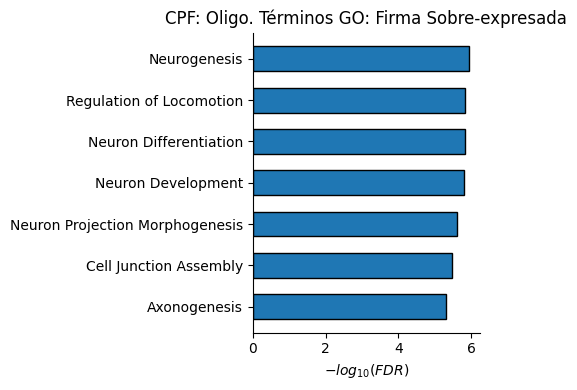

In [304]:
data = {
    'Term': [
            'Neurogenesis',
            'Axonogenesis',
            'Neuron Differentiation',
            'Neuron Projection Morphogenesis',
            'Neuron Development',
            "Regulation of Locomotion",
            "Cell Junction Assembly"
    ],
    'FDR': [1.12E-06,4.72E-06,1.48E-06,2.35E-06,1.53E-06,1.42E-06,3.42E-06]
}
df = pd.DataFrame(data)
df['log10_FDR'] = -np.log10(df['FDR'])
df = df.sort_values('log10_FDR', ascending=True)
fig, ax = plt.subplots(figsize=(5, 4))
bars = ax.barh(df['Term'], df['log10_FDR'], edgecolor='black', height=0.6)
ax.set_xlabel(r'$-log_{10}(FDR)$')
ax.set_title('CPF: Oligo. Términos GO: Firma Sobre-expresada')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.tight_layout()
plt.show()

# Subcluster analysis Astro Integracion scvi

In [ ]:
astro_barcodes = adata.obs[adata.obs['cell_type'] == 'Astro'].index
adata_full = adata.raw.to_adata()
adata_astro = adata_full[astro_barcodes].copy()
adata_astro.obs = adata.obs.loc[astro_barcodes].copy()
sc.pp.highly_variable_genes(
    adata_astro, 
    flavor="seurat_v3", 
    n_top_genes=2000, 
    subset=False
)
adata_subset_oligo = adata_astro[:, adata_astro.var['highly_variable']].copy()
scvi.model.SCVI.setup_anndata(
    adata_subset_oligo, 
    categorical_covariate_keys=['Patient'], 
    continuous_covariate_keys=['pct_counts_mt', 'pct_counts_ribo']
)
model = scvi.model.SCVI(adata_subset_oligo, n_layers=2, n_latent=30, gene_likelihood="nb")
model.train(max_epochs=200, early_stopping=True, early_stopping_patience = 5)
adata_astro.obsm['X_scVI'] = model.get_latent_representation()
sc.pp.normalize_total(adata_astro)
sc.pp.log1p(adata_astro)
adata_astro.raw = adata_astro 
sc.pp.neighbors(adata_astro, use_rep='X_scVI')
sc.tl.umap(adata_astro)
sc.tl.leiden(adata_astro, resolution=0.3)
sc.pl.umap(adata_astro, color=["leiden", "Patient"])

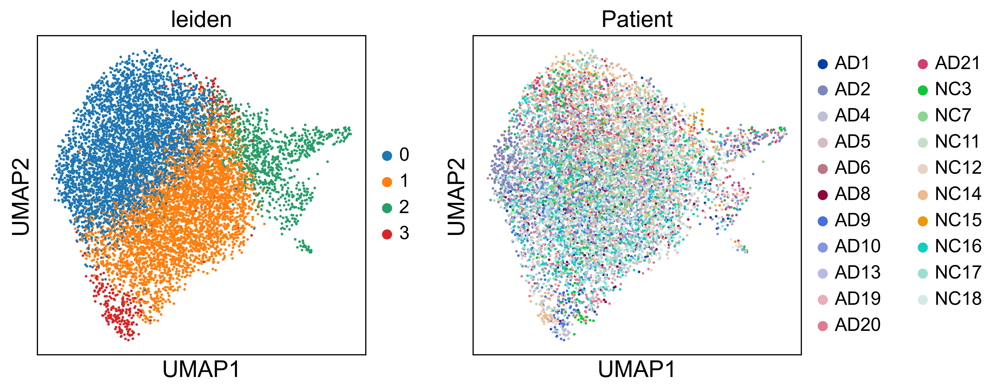

In [159]:
sc.pp.neighbors(adata_astro, use_rep='X_scVI')
sc.tl.umap(adata_astro)
sc.tl.leiden(adata_astro, resolution=0.5)
sc.pl.umap(adata_astro, color=["leiden", "Patient"])

In [ ]:
clusters = sorted(adata_astro.obs['leiden'].unique(), key=int)
cluster_map = {cl: f"a{int(cl)+1}" for cl in clusters}

adata_astro.obs['Acluster'] = adata_astro.obs['leiden'].map(cluster_map)

c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\plotting\_utils.py:482: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list
c:\Users\User\AppData\Local\Programs\Python\Python313\Lib\site-packages\scanpy\plotting\_utils.py:482: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + "_colors"] = colors_list


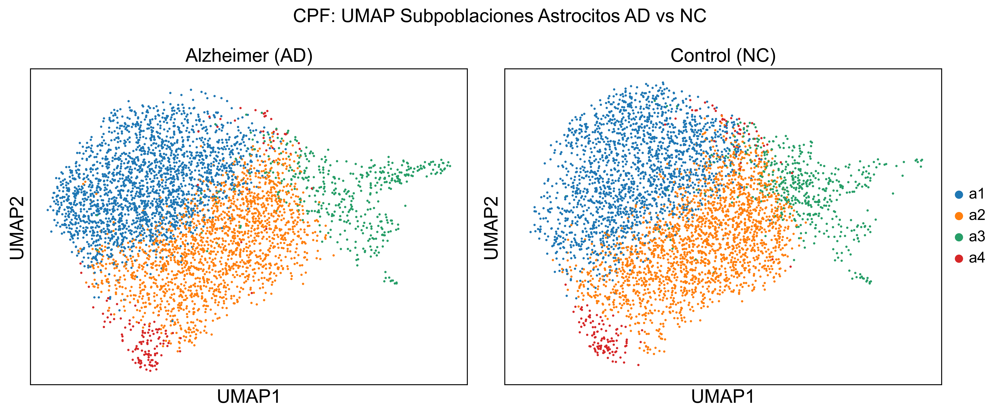

In [162]:
import matplotlib.pyplot as plt
umap_coords = adata_astro.obsm['X_umap']
x_min, x_max = umap_coords[:, 0].min(), umap_coords[:, 0].max()
y_min, y_max = umap_coords[:, 1].min(), umap_coords[:, 1].max()
pad = 0.5 

fig, axs = plt.subplots(1, 2, figsize=(12, 5))
sc.pl.umap(adata_astro[adata_astro.obs['Condition'] == 'AD'], 
           color='Acluster', title='Alzheimer (AD)', 
           ax=axs[0], show=False, size=15, legend_loc=None)
sc.pl.umap(adata_astro[adata_astro.obs['Condition'] == 'NC'], 
           color='Acluster', title='Control (NC)', 
           ax=axs[1], show=False, size=15)
for ax in axs:
    ax.set_xlim(x_min - pad, x_max + pad)
    ax.set_ylim(y_min - pad, y_max + pad)

fig.suptitle('CPF: UMAP Subpoblaciones Astrocitos AD vs NC', fontsize=16)
plt.tight_layout()
plt.show()

# Up y downregulations + GO Analisis Astrocitos

In [163]:
import pandas as pd

ct = adata_astro.obs.groupby(["Acluster", "Condition"]).size().unstack(fill_value=0)

ct["prop_AD"] = ct["AD"] / ct["AD"].sum()
ct["prop_NC"] = ct["NC"] / ct["NC"].sum()

ct["delta"] = (ct["prop_AD"] - ct["prop_NC"]) * 100
ct


C:\Users\User\AppData\Local\Temp\ipykernel_24520\3133573323.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ct = adata_astro.obs.groupby(["Acluster", "Condition"]).size().unstack(fill_value=0)


Condition,AD,NC,prop_AD,prop_NC,delta
Acluster,,,,,
a1,2210,1918,0.479913,0.414613,6.530008
a2,1785,2043,0.387622,0.441634,-5.401209
a3,453,505,0.098371,0.109166,-1.079425
a4,157,160,0.034093,0.034587,-0.049374


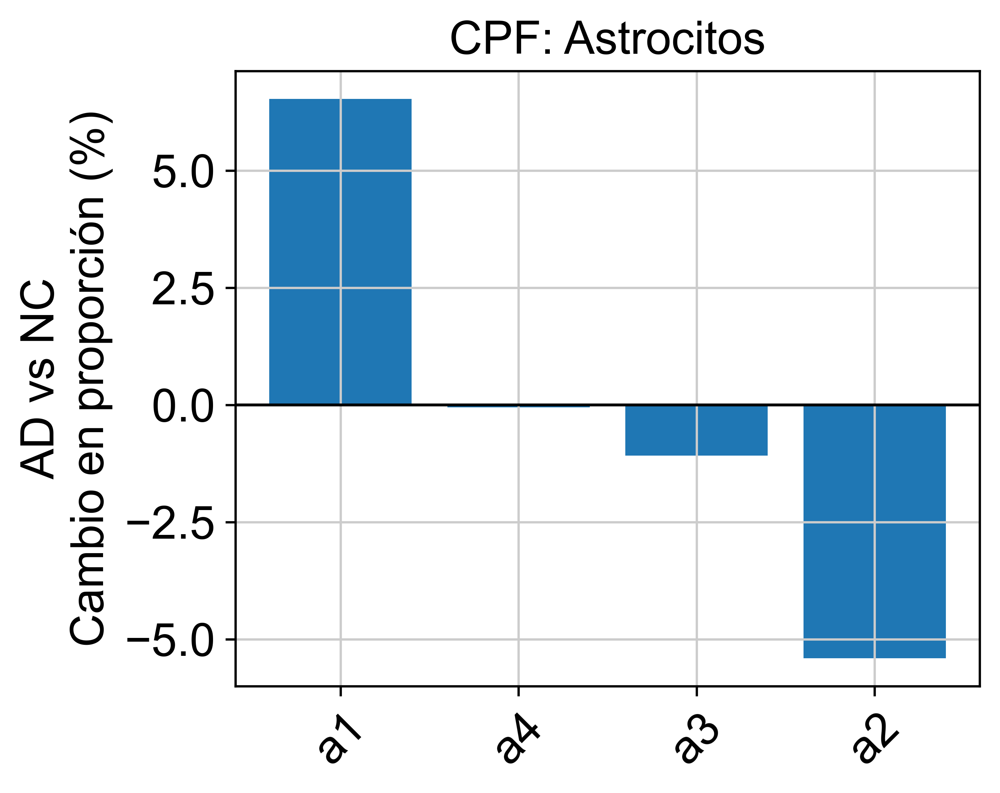

In [164]:
import matplotlib.pyplot as plt
ct_sorted = ct.sort_values("delta", ascending=False)
fig, ax = plt.subplots(figsize=(5, 4))

x = range(len(ct_sorted))

ax.bar(x, ct_sorted["delta"])

ax.set_xticks(x)
ax.set_xticklabels(ct_sorted.index, rotation=45)

ax.axhline(0, color="black", linewidth=1)

ax.set_ylabel("AD vs NC\nCambio en proporción (%)")
ax.set_title("CPF: Astrocitos")

plt.tight_layout()
plt.show()


Correcto: Calculando firmas sobre 23712 genes.
Firma UP: 440 genes | Firma DOWN: 1806 genes


C:\Users\User\AppData\Local\Temp\ipykernel_24520\3568305397.py:43: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_means = df_expr.groupby(cluster_col).mean()


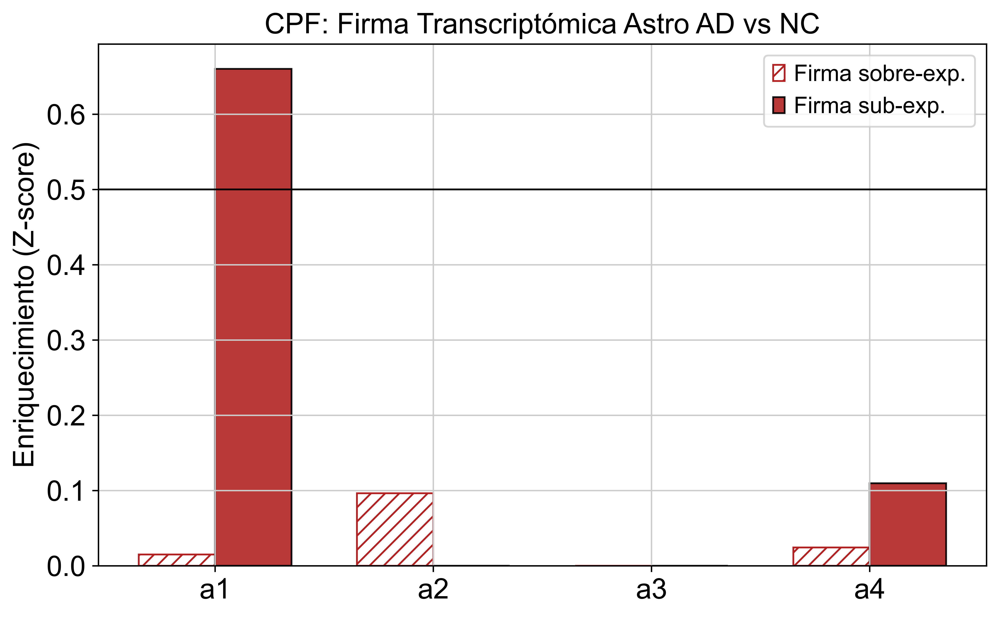

In [170]:
from scipy.stats import zscore
if adata_astro.n_vars < 5000:
    print("⚠️ PELIGRO: Parece que solo tienes los HVGs (pocos genes).")
    print("Necesitas el objeto con todos los genes (20k+) para calcular firmas reales.")
else:
    print(f"Correcto: Calculando firmas sobre {adata_astro.n_vars} genes.")

sc.tl.rank_genes_groups(
    adata_astro,
    groupby='Condition',
    method='wilcoxon',
    use_raw=True,
    pts=True,
    key_added='rank_genes_AD_vs_NC'
)

res_global = sc.get.rank_genes_groups_df(adata_astro, group='AD', key='rank_genes_AD_vs_NC')

up_signature = res_global[(res_global['pvals_adj'] < 0.1) & (res_global['logfoldchanges'] > 0.1)]['names'].tolist()
down_signature = res_global[(res_global['pvals_adj'] < 0.1) & (res_global['logfoldchanges'] < -0.1)]['names'].tolist()

print(f"Firma UP: {len(up_signature)} genes | Firma DOWN: {len(down_signature)} genes")

cluster_col = 'Acluster'

genes_of_interest = list(set(up_signature + down_signature))

genes_of_interest = [g for g in genes_of_interest if g in adata_astro.var_names]

if len(genes_of_interest) > 0:
    data_subset = adata_astro[:, genes_of_interest].X
    
    if scipy.sparse.issparse(data_subset):
        data_subset = data_subset.toarray()
        
    df_expr = pd.DataFrame(
        data_subset,
        index=adata_astro.obs_names,
        columns=genes_of_interest
    )
    df_expr[cluster_col] = adata_astro.obs[cluster_col].values

    cluster_means = df_expr.groupby(cluster_col).mean()

    z_matrix = cluster_means.apply(zscore, axis=0).fillna(0)

    enrichment_scores = pd.DataFrame(index=cluster_means.index)
    
    valid_up = [g for g in up_signature if g in z_matrix.columns]
    valid_down = [g for g in down_signature if g in z_matrix.columns]

    enrichment_scores['Firma sobreexp.'] = z_matrix[valid_up].mean(axis=1)
    enrichment_scores['Firma subexp.'] = z_matrix[valid_down].mean(axis=1)* -1

    fig, ax = plt.subplots(figsize=(8, 5))
    x = np.arange(len(enrichment_scores))
    width = 0.35

    up_values = enrichment_scores['Firma sobreexp.'].clip(lower=0)
    down_values = enrichment_scores['Firma subexp.'].clip(lower=0)

    ax.bar(x - width/2, up_values, width, label='Firma sobre-exp.', color='white', edgecolor='firebrick', hatch='///')
    ax.bar(x + width/2, down_values, width, label='Firma sub-exp.', color='firebrick', edgecolor='black', alpha=0.9)

    ax.axhline(y=0.5, color='black', linestyle='-', linewidth=1)
    ax.set_ylabel('Enriquecimiento (Z-score)')
    ax.set_xticks(x)
    ax.set_xticklabels(enrichment_scores.index)
    ax.legend()
    ax.set_title('CPF: Firma Transcriptómica Astro AD vs NC')
    
    plt.tight_layout()
    plt.show()

else:
    print("Error: No se encontraron genes de la firma en el objeto. Revisa si adata_oligo tiene los genes correctos.")

In [167]:
cluster_map = {
    'a1': 'Downregulated',
    'a2': 'Stable',
    'a3': 'Stable',
    'a4': 'Stable'
}
adata_astro.obs['subpop_status'] = adata_astro.obs['Acluster'].map(cluster_map)
adata_astro.obs['subpop_status'] = adata_astro.obs['subpop_status'].fillna('Other')
print(adata_astro.obs['subpop_status'].value_counts())

sc.tl.rank_genes_groups(adata_astro, groupby='subpop_status', method='wilcoxon', pts=True, use_raw=True)
dedf = sc.get.rank_genes_groups_df(adata_astro, group='Downregulated')
genes_significativos = dedf[
    (dedf['pvals_adj'] < 0.1) & 
    (dedf['logfoldchanges'] > 0.1)
].sort_values('logfoldchanges', ascending=False)

print(f"Genes encontrados: {len(genes_significativos)}")

subpop_status
Stable           5103
Downregulated    4128
Name: count, dtype: int64
Genes encontrados: 287


In [ ]:
print(genes_significativos[['names', 'logfoldchanges', 'pvals_adj']].head(10))

lista_para_GO = genes_significativos['names'].tolist()

print(f"Tienes {len(lista_para_GO)} genes para analizar.")
print("Copia estos genes:")
print('\n'.join(lista_para_GO))

      names  logfoldchanges      pvals_adj
134    SMTN        0.915426   1.355292e-07
139   MFGE8        0.846866   3.144056e-07
21     MT2A        0.833867   3.175901e-74
145    MT1G        0.817755   7.257604e-06
54     MT1E        0.790505   2.758207e-24
0    COL5A3        0.775027  2.695777e-159
167    MT1M        0.764614   2.454031e-03
86    ITGA7        0.734186   3.542648e-15
1       CLU        0.730807  9.806003e-155
8    ATP1B2        0.729313  5.356756e-108
Tienes 416 genes para analizar.
Copia estos genes:
SMTN
MFGE8
MT2A
MT1G
MT1E
COL5A3
MT1M
ITGA7
CLU
ATP1B2
GPR37L1
GLUL
EPHX1
APOE
CST3
WFS1
LCNL1
KCNJ10
CKB
SNTA1
MT3
FGFR3
MICALL2
TTYH1
PLXNB1
GJA1
ATP1A2
INPPL1
NFATC4
AIFM3
TUBB2B
NCAN
METRN
RAPGEF3
SLC3A2
NDRG2
ITM2C
AGT
GRIN2C
WIF1
PBXIP1
SLC1A2
B4GALNT4
NAT8L
ENHO
SDC4
MLC1
SLC25A29
MT1X
SLC25A18
MRAS
SLC27A1
ADGRG1
ACSS1
SFXN5
SOX9
C1orf61
SLC6A11
HPSE2
ENO1
LGI4
HIF3A
HEPACAM
TPD52L1
CD81
ACADVL
EMX2
APC2
GFAP
VAV3
SLC1A3
PHGDH
CABLES1
SLC39A12
AC016716.2
CD63
FAM1

In [173]:
print('\n'.join(genes_down))

EEFSEC
SNRNP200
MCTS1
NDEL1
CAB39
ZCCHC4
AC005480.1
AC018816.1
DBF4B
SUPT7L
SEC23B
MRPL33
RPP38
SLC44A1
AL355974.2
WIPF1
BNIP3
WDR43
CTNNBL1
AP001528.2
SPDYE3
CYREN
CABIN1
HOOK2
ELMSAN1
METAP2
STAG3
NAA50
XPA
LUC7L2
FYCO1
TSG101
TTTY10
SENP2
CACNB1
NALCN
FAM118A
DDX52
SECISBP2
TRIP4
FAM193B
WDR91
ATP5S
LMAN2L
PBX4
FOXK1
LARP1B
UTP6
TRABD
EEF1AKMT1
BRD4
EBPL
ARL5A
EPB41
LRRC58
EIF3K
RLIM
TMEM209
GFPT2
AC016907.2
AL024498.2
CERS5
RMI1
ALAD
USP12
MBIP
PAG1
AGAP9
ZNF507
ALG5
CDC34
IQCE
ALKBH1
C6orf106
PNN
PRTG
CTBS
USF2
C2CD3
TRIM28
MEAF6
C1GALT1
ECI1
PPP2R2A
VXN
RNF10
ZNF283
KANSL3
ANGEL1
NEDD9
ZNF430
CWC22
WDR45
TET3
DCDC1
ZC3H15
CPNE1
KLC4
ZFP14
FSD1L
ZNF555
ZFPM1
KRIT1
CTNNA3
CHURC1-FNTB
ARMC3
Z93930.2
PKIB
DTX3
EXD2
GRAMD4
COG2
MINDY2
FAM160B2
ALG10B
DGKZ
ZFYVE1
RIOK3
ENDOD1
ZNF439
IKBKB
ZCCHC8
CYP2R1
TRAPPC6B
METTL3
OGG1
AC138123.1
GPR135
DESI2
RBKS
DDX59
TBKBP1
DPH7
MICU3
ZNF69
RAB21
LBR
KHDRBS1
CSDE1
AGAP1
CASC1
STRN
RC3H2
FGFR1OP2
ZNF592
MMS19
TATDN1
PLA2G4C
C5orf15
YIPF1
H2AFY
SU

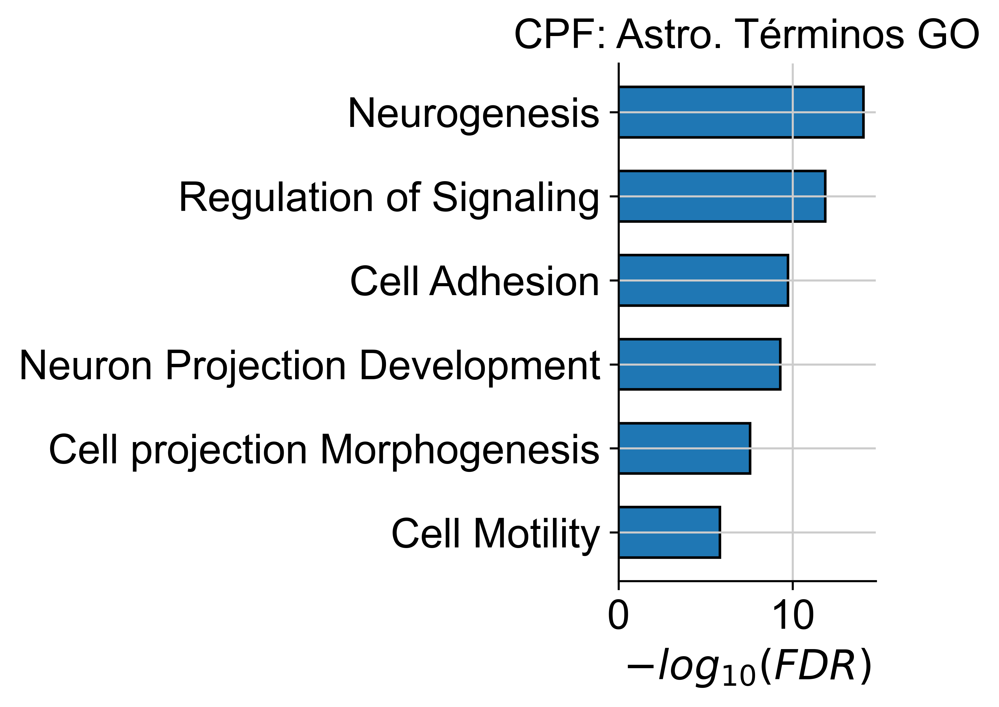

In [174]:
data = {
    'Term': [
            'Neurogenesis',
            'Cell Motility',
            'Regulation of Signaling',
            'Neuron Projection Development',
            'Cell projection Morphogenesis',
            'Cell Adhesion'
    ],
    'FDR': [8.19E-15,1.46E-06,1.31E-12,5.11E-10,2.76E-08,1.82E-10]
}
df = pd.DataFrame(data)
df['log10_FDR'] = -np.log10(df['FDR'])
df = df.sort_values('log10_FDR', ascending=True)
fig, ax = plt.subplots(figsize=(5, 4))
bars = ax.barh(df['Term'], df['log10_FDR'], edgecolor='black', height=0.6)
ax.set_xlabel(r'$-log_{10}(FDR)$')
ax.set_title('CPF: Astro. Términos GO')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.tight_layout()
plt.show()

Calculando genes diferenciales...
Genes UP encontrados: 144
Genes DOWN encontrados: 3408

--- RESULTADOS HALLMARK (DOWN) ---
                        Term  Adjusted P-value  \
0            Mitotic Spindle      2.835912e-10   
1          Protein Secretion      2.835912e-10   
2             UV Response Dn      7.414506e-04   
3            G2-M Checkpoint      1.919403e-02   
4         TGF-beta Signaling      2.687176e-02   
5            heme Metabolism      5.855293e-02   
6          Androgen Response      5.855293e-02   
7  Oxidative Phosphorylation      2.545832e-01   
8   PI3K/AKT/mTOR  Signaling      4.218377e-01   
9             Myc Targets V1      9.999956e-01   

                                               Genes  
0  YWHAE;TRIO;NUMA1;WASL;PKD2;PREX1;AKAP13;PCM1;P...  
1  TSG101;SGMS1;COPB1;CLTC;SNAP23;USO1;CLCN3;RAB2...  
2  PHF3;YTHDC1;CELF2;COL11A1;PTEN;MRPS31;PTPRM;PT...  
3  CCNT1;NUMA1;HNRNPU;ARID4A;RPS6KA5;XPO1;KIF5B;C...  
4  ACVR1;SMAD1;BMPR2;SMAD3;SLC20A1;SMURF1;UBE2D3;

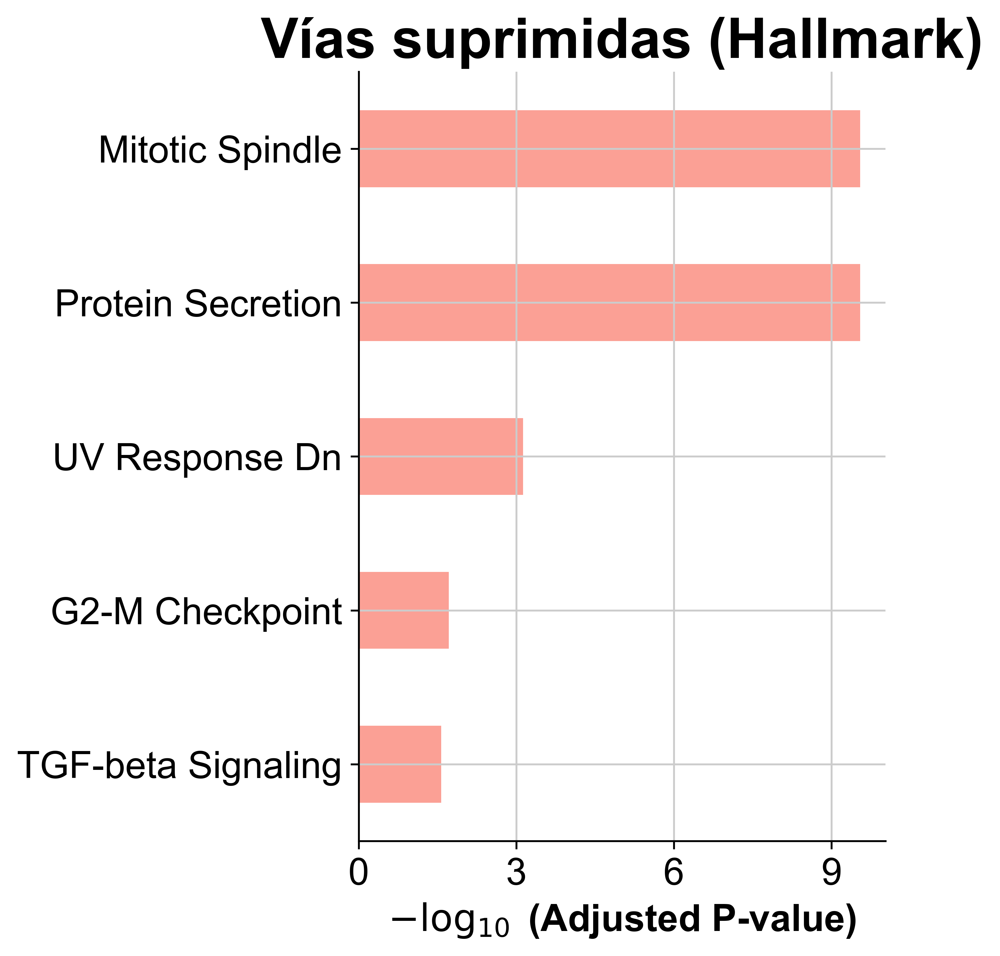


--- RESULTADOS HALLMARK (UP) ---
                                Term  Adjusted P-value  \
0  Epithelial Mesenchymal Transition      8.929725e-07   
1                            Hypoxia      3.643178e-05   
2                         Myogenesis      1.879975e-04   
3                          Apoptosis      1.594653e-03   
4                        Coagulation      3.385513e-03   
5            Estrogen Response Early      3.385513e-03   
6             Estrogen Response Late      3.385513e-03   
7                       Adipogenesis      1.394726e-02   
8                        p53 Pathway      1.394726e-02   
9                     UV Response Dn      1.482054e-02   

                                               Genes  
0  PDGFRB;GJA1;SGCD;CADM1;LRP1;SERPINE2;SDC4;COL5...  
1  BCAN;MT2A;SDC4;NCAN;DDIT4;ENO1;ANGPTL4;F3;MT1E...  
2    SMTN;MRAS;SGCD;FXYD1;ITGA7;CKB;TPD52L1;CLU;CNN3  
3             PDGFRB;TGFB2;AIFM3;HGF;HSPB1;TIMP3;CLU  
4                    LRP1;HTRA1;TIMP3;CLU;F3;RAPGEF3

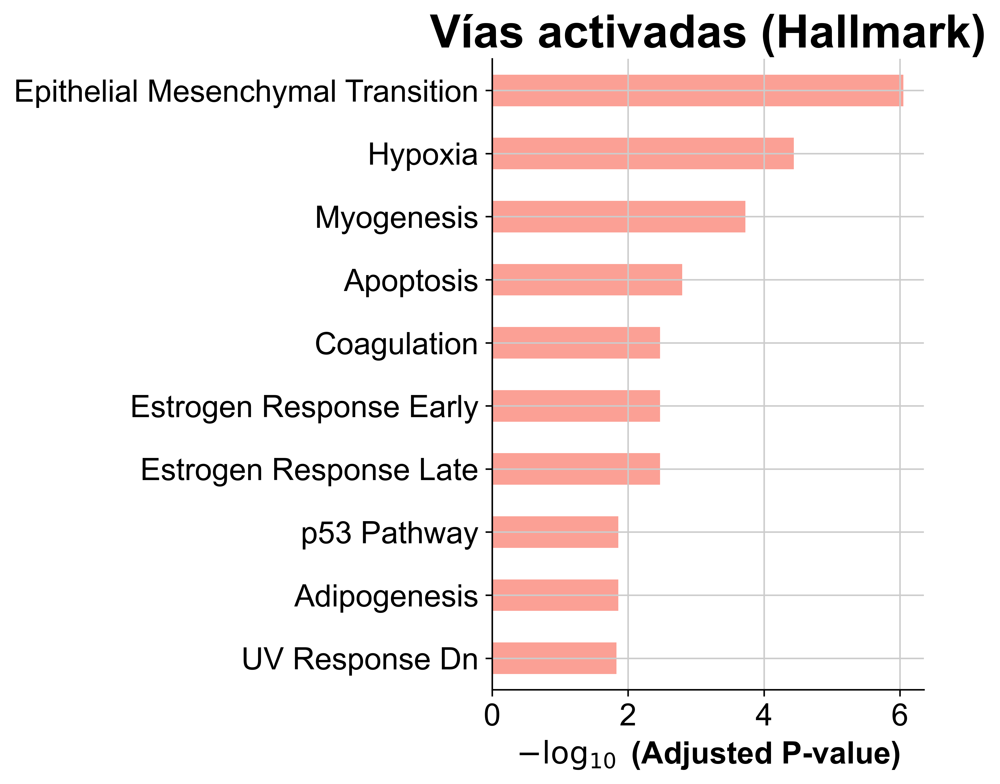

In [ ]:
import scanpy as sc
import gseapy as gp
import matplotlib.pyplot as plt

cluster_map = {
    'a1': 'Downregulated',
    'a2': 'Stable',
    'a3': 'Stable',
    'a4': 'Stable'
}
adata_astro.obs['analysis_group'] = adata_astro.obs['Acluster'].map(cluster_map).fillna('Reference')

print("Calculando genes diferenciales...")
sc.tl.rank_genes_groups(adata_astro, groupby='subpop_status', method='wilcoxon', pts=True, use_raw=True, n_genes=None)

dedf = sc.get.rank_genes_groups_df(adata_astro, group='Downregulated')

genes_up = dedf[ (dedf['pvals_adj'] < 0.05) & (dedf['logfoldchanges'] > 0.25) ]['names'].tolist()
genes_down = dedf[ (dedf['pvals_adj'] < 0.05) & (dedf['logfoldchanges'] < -0.25) ]['names'].tolist()

print(f"Genes UP encontrados: {len(genes_up)}")
print(f"Genes DOWN encontrados: {len(genes_down)}")

if len(genes_down) > 5:
    enr_down = gp.enrichr(gene_list=genes_down,
                          gene_sets='MSigDB_Hallmark_2020',
                          organism='human', 
                          cutoff=0.05)
    
    if not enr_down.results.empty:
        print("\n--- RESULTADOS HALLMARK (DOWN) ---")
        print(enr_down.results[['Term', 'Adjusted P-value', 'Genes']].head(10))
        
        from gseapy import barplot
        ax = barplot(enr_down.res2d, title='Vías suprimidas (Hallmark)', cutoff=0.05)
        plt.show()
    else:
        print("No se encontraron vías significativas en DOWN.")
else:
    print("No hay suficientes genes DOWN para analizar.")

if len(genes_up) > 5:
    enr_up = gp.enrichr(gene_list=genes_up,
                        gene_sets='MSigDB_Hallmark_2020',
                        organism='human', 
                        cutoff=0.05)
    
    if not enr_up.results.empty:
        print("\n--- RESULTADOS HALLMARK (UP) ---")
        print(enr_up.results[['Term', 'Adjusted P-value', 'Genes']].head(10))
        
        ax = barplot(enr_up.res2d, title='Vías activadas (Hallmark)', cutoff=0.05)
        plt.show()

In [169]:
enr_down.results

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,MSigDB_Hallmark_2020,Mitotic Spindle,74/199,6.987906e-12,2.835912e-10,0,0,2.923954,7.510715e+01,YWHAE;TRIO;NUMA1;WASL;PKD2;PREX1;AKAP13;PCM1;P...
1,MSigDB_Hallmark_2020,Protein Secretion,45/96,1.134365e-11,2.835912e-10,0,0,4.339875,1.093751e+02,TSG101;SGMS1;COPB1;CLTC;SNAP23;USO1;CLCN3;RAB2...
2,MSigDB_Hallmark_2020,UV Response Dn,44/144,4.448704e-05,7.414506e-04,0,0,2.157099,2.161480e+01,PHF3;YTHDC1;CELF2;COL11A1;PTEN;MRPS31;PTPRM;PT...
3,MSigDB_Hallmark_2020,G2-M Checkpoint,51/200,1.535522e-03,1.919403e-02,0,0,1.676539,1.086210e+01,CCNT1;NUMA1;HNRNPU;ARID4A;RPS6KA5;XPO1;KIF5B;C...
4,MSigDB_Hallmark_2020,TGF-beta Signaling,18/54,2.687176e-03,2.687176e-02,0,0,2.441888,1.445418e+01,ACVR1;SMAD1;BMPR2;SMAD3;SLC20A1;SMURF1;UBE2D3;...
5,MSigDB_Hallmark_2020,heme Metabolism,48/200,7.265299e-03,5.855293e-02,0,0,1.545113,7.609133e+00,USP15;EPB41;MGST3;ENDOD1;GMPS;NR3C1;FOXO3;CLCN...
6,MSigDB_Hallmark_2020,Androgen Response,27/100,8.197410e-03,5.855293e-02,0,0,1.807089,8.681141e+00,ABHD2;NGLY1;GNAI3;PTPN21;SAT1;CDC14B;AKAP12;LM...
7,MSigDB_Hallmark_2020,Oxidative Phosphorylation,44/200,4.073331e-02,2.545832e-01,0,0,1.378060,4.410770e+00,SLC25A3;ABCB7;COX15;ECI1;MGST3;ATP5MC2;ETFDH;D...
8,MSigDB_Hallmark_2020,PI3K/AKT/mTOR Signaling,24/105,7.593079e-02,4.218377e-01,0,0,1.445670,3.726841e+00,SMAD2;ACTR3;GSK3B;CAB39;CAB39L;MAPKAP1;STAT2;U...
9,MSigDB_Hallmark_2020,Myc Targets V1,38/200,2.552012e-01,9.999956e-01,0,0,1.143606,1.561826e+00,YWHAE;SLC25A3;PSMD14;GLO1;CUL1;HNRNPU;HNRNPR;P...


Entrenando con 6461 células. Testeando con 2770 células.

--- REPORTE DE CLASIFICACIÓN ---
              precision    recall  f1-score   support

          NC       0.94      0.94      0.94      1388
          AD       0.94      0.94      0.94      1382

    accuracy                           0.94      2770
   macro avg       0.94      0.94      0.94      2770
weighted avg       0.94      0.94      0.94      2770



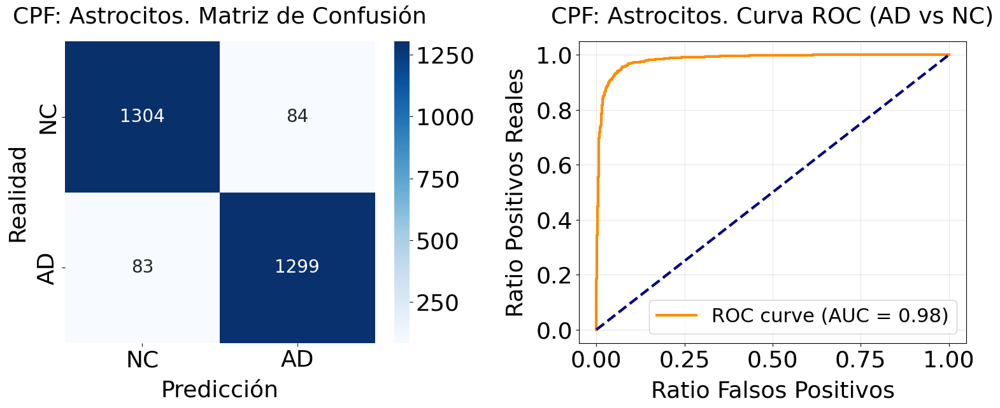


--- TOP 20 GENES PREDICTORES ---
            Gene  Coefficient
1120       CCND3     1.013284
2670      ABCA10     0.868688
1693      FAM95C    -0.861383
1290     DPY19L1    -0.750123
2175         HAL     0.673379
863      GALNTL6    -0.661534
2014      PAPSS2    -0.637646
2682     C1QTNF1     0.635480
2715      GALNT1     0.613475
2060        ERC1     0.608020
254         OPN3    -0.570830
138         SV2A    -0.528062
1127    TNFRSF21     0.522019
2614       COX10    -0.519173
1355  AC005487.1    -0.513539
1543  AC104561.1     0.487585
72    AL445193.2    -0.486036
1203     L3MBTL3     0.483367
2816      DNAJC5    -0.409054
949   AC018754.1     0.397441


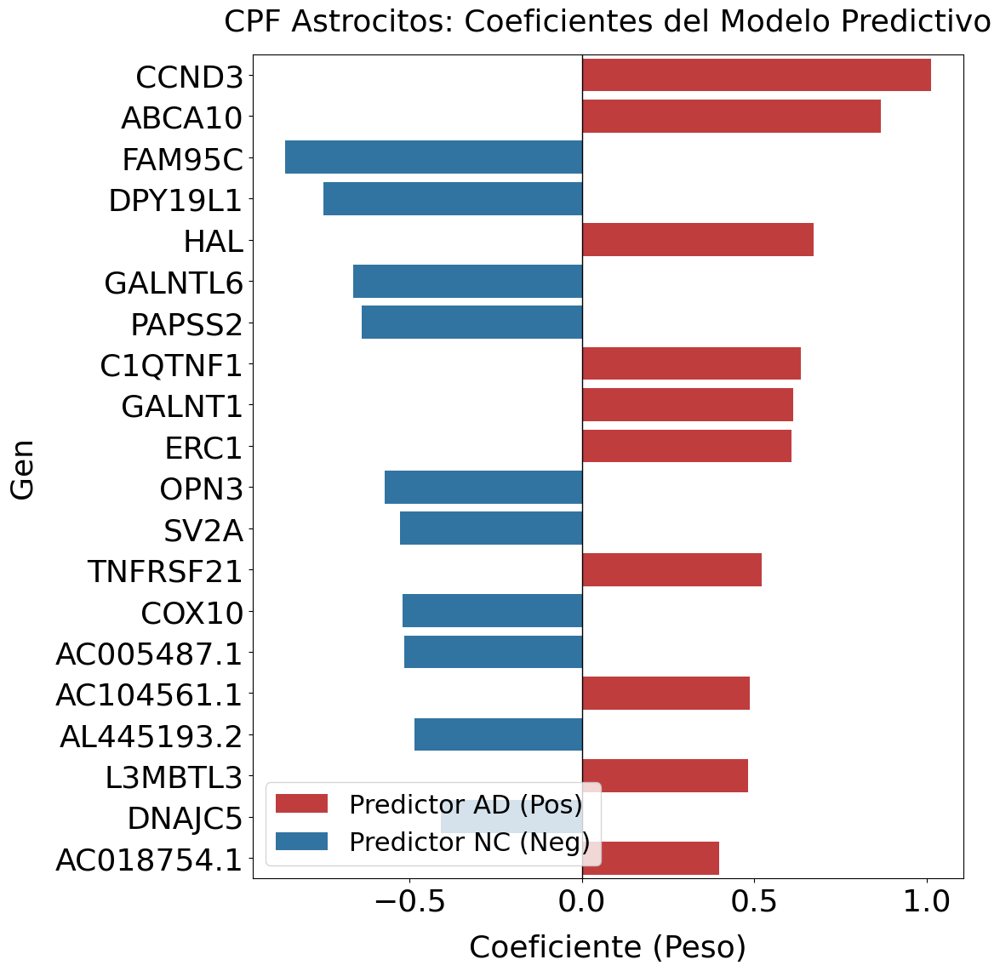

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_curve, auc, confusion_matrix

plt.rcParams.update({
    'font.size': 26,
    'axes.titlesize': 26,
    'axes.labelsize': 26,
    'xtick.labelsize': 26,
    'ytick.labelsize': 26,
    'legend.fontsize': 22,
    'figure.titlesize': 26
})

adata.obs['Condition'] = adata.obs['Patient'].str[:2]
astro_barcodes = adata.obs[adata.obs['cell_type'] == 'Astro'].index
adata_full = adata.raw.to_adata()
adata_astro = adata_full[astro_barcodes].copy()
adata_astro.obs = adata.obs.loc[astro_barcodes].copy()

sc.pp.highly_variable_genes(
    adata_astro, 
    flavor="seurat_v3", 
    n_top_genes=3000, 
    subset=False
)

adata_astro = adata_astro[:, adata_astro.var['highly_variable']] 

X = adata_astro.X
if hasattr(X, "toarray"):
    X = X.toarray()

y = adata_astro.obs['Condition'].map({'AD': 1, 'NC': 0, 'HC': 0}).values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

print(f"Entrenando con {X_train.shape[0]} células. Testeando con {X_test.shape[0]} células.")

model = LogisticRegression(penalty='l1', C=0.1, solver='liblinear', random_state=42, max_iter=1000)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
y_prob = model.predict_proba(X_test)[:, 1]

print("\n--- REPORTE DE CLASIFICACIÓN ---")
print(classification_report(y_test, y_pred, target_names=['NC', 'AD']))


fig, ax = plt.subplots(1, 2, figsize=(16, 7))

cm = confusion_matrix(y_test, y_pred)

sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax[0], annot_kws={"size": 20})
ax[0].set_title('CPF: Astrocitos. Matriz de Confusión', pad=20)
ax[0].set_xlabel('Predicción', labelpad=10)
ax[0].set_ylabel('Realidad', labelpad=10)
ax[0].set_xticklabels(['NC', 'AD'])
ax[0].set_yticklabels(['NC', 'AD'])

fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)
ax[1].plot(fpr, tpr, color='darkorange', lw=3, label=f'ROC curve (AUC = {roc_auc:.2f})')
ax[1].plot([0, 1], [0, 1], color='navy', lw=3, linestyle='--')
ax[1].set_xlabel('Ratio Falsos Positivos', labelpad=10)
ax[1].set_ylabel('Ratio Positivos Reales', labelpad=10)
ax[1].set_title('CPF: Astrocitos. Curva ROC (AD vs NC)', pad=20)
ax[1].legend(loc="lower right", frameon=True, fancybox=True, framealpha=0.9)
ax[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

coefs = pd.DataFrame({
    'Gene': adata_oligo.var_names,
    'Coefficient': model.coef_[0]
})
coefs['Abs_Coeff'] = coefs['Coefficient'].abs()
top_genes = coefs.sort_values('Abs_Coeff', ascending=False).head(20)

top_genes['Association'] = np.where(top_genes['Coefficient'] > 0, 'Predictor AD (Pos)', 'Predictor NC (Neg)')

print("\n--- TOP 20 GENES PREDICTORES ---")
print(top_genes[['Gene', 'Coefficient']])

plt.figure(figsize=(12, 12)) 

sns.barplot(
    data=top_genes, 
    x='Coefficient', 
    y='Gene', 
    hue='Association',
    palette={'Predictor AD (Pos)': '#d62728', 'Predictor NC (Neg)': '#1f77b4'},
    dodge=False
)

plt.title('CPF Astrocitos: Coeficientes del Modelo Predictivo', pad=20)
plt.xlabel('Coeficiente (Peso)', labelpad=15)
plt.ylabel('Gen', labelpad=15)
plt.axvline(0, color='black', linestyle='-', linewidth=1)
plt.legend(loc='lower left')


plt.tight_layout()
plt.show()

Entrenando con 11841 células. Testeando con 5076 células.

--- REPORTE DE CLASIFICACIÓN ---
              precision    recall  f1-score   support

          NC       0.93      0.94      0.94      2835
          AD       0.93      0.92      0.92      2241

    accuracy                           0.93      5076
   macro avg       0.93      0.93      0.93      5076
weighted avg       0.93      0.93      0.93      5076



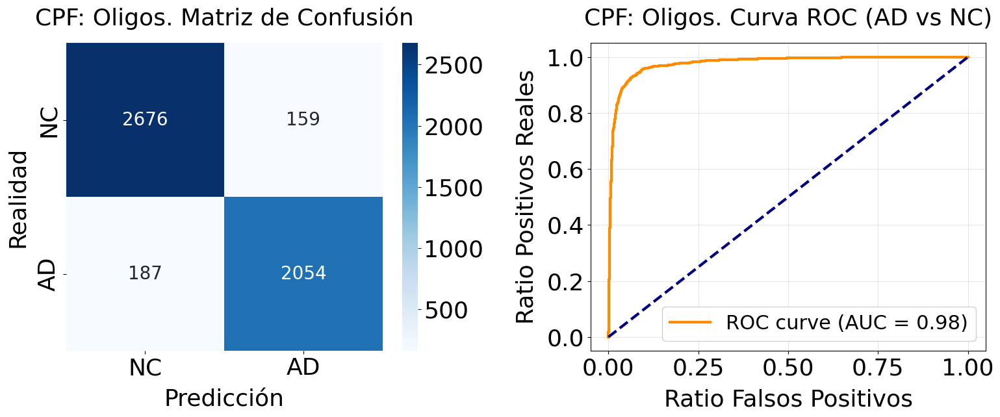


--- TOP 20 GENES PREDICTORES ---
            Gene  Coefficient
1337        ASNS    -3.843343
2396        FMN1     1.141297
2316       CDKL1     0.955297
1000    ADAMTS19    -0.885273
2388       PWRN1    -0.849067
917        ARL15     0.819483
1167       PNISR     0.741030
1694    ANKRD18A     0.723778
2122     SLC38A1    -0.716176
2734      RNF152    -0.705800
1315     CCDC146     0.654970
148       S100A6     0.630894
2290    SLC22A17     0.630891
531       GOLGA4     0.614956
2163      CCDC59     0.598212
2021       CPEB3     0.592089
1124    HSP90AB1     0.584526
2531      TNRC6A     0.581230
668   AC092920.1    -0.578355
288        LTBP1     0.520790


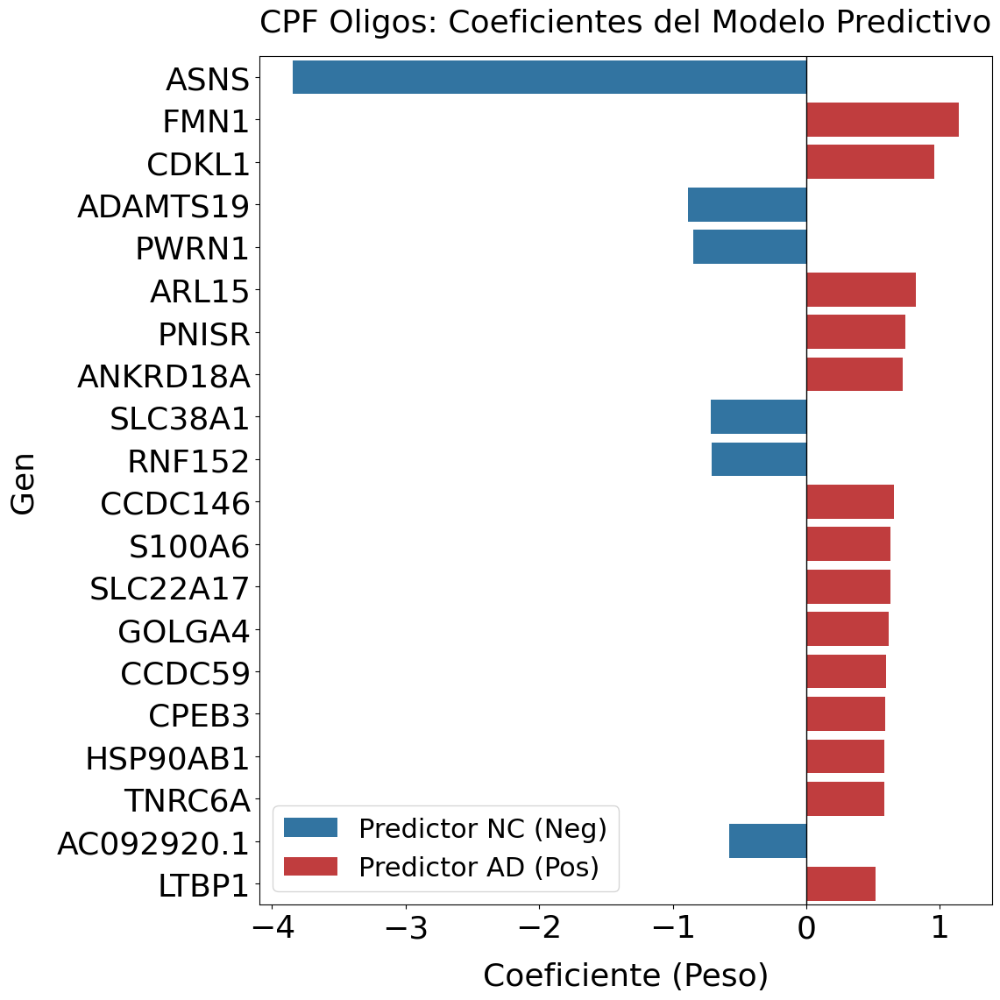

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, roc_curve, auc, confusion_matrix
from sklearn.preprocessing import StandardScaler

plt.rcParams.update({
    'font.size': 26,
    'axes.titlesize': 26,
    'axes.labelsize': 26,
    'xtick.labelsize': 26,
    'ytick.labelsize': 26,
    'legend.fontsize': 22,
    'figure.titlesize': 26
})

oligo_barcodes = adata.obs[adata.obs['cell_type'] == 'Oligo'].index
adata_full = adata.raw.to_adata()
adata_oligo = adata_full[oligo_barcodes].copy()
adata_oligo.obs = adata.obs.loc[oligo_barcodes].copy()

sc.pp.highly_variable_genes(
    adata_oligo, 
    flavor="seurat_v3", 
    n_top_genes=3000, 
    subset=False
)

adata_oligo = adata_oligo[:, adata_oligo.var['highly_variable']] 

X = adata_oligo.X
if hasattr(X, "toarray"):
    X = X.toarray()

y = adata_oligo.obs['Condition'].map({'AD': 1, 'NC': 0, 'HC': 0}).values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)

print(f"Entrenando con {X_train.shape[0]} células. Testeando con {X_test.shape[0]} células.")

model = LogisticRegression(penalty='l1', C=0.1, solver='liblinear', random_state=42, max_iter=1000)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
y_prob = model.predict_proba(X_test)[:, 1]

print("\n--- REPORTE DE CLASIFICACIÓN ---")
print(classification_report(y_test, y_pred, target_names=['NC', 'AD']))

fig, ax = plt.subplots(1, 2, figsize=(16, 7))

cm = confusion_matrix(y_test, y_pred)
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax[0], annot_kws={"size": 20})
ax[0].set_title('CPF: Oligos. Matriz de Confusión', pad=20)
ax[0].set_xlabel('Predicción', labelpad=10)
ax[0].set_ylabel('Realidad', labelpad=10)
ax[0].set_xticklabels(['NC', 'AD'])
ax[0].set_yticklabels(['NC', 'AD'])

fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)
ax[1].plot(fpr, tpr, color='darkorange', lw=3, label=f'ROC curve (AUC = {roc_auc:.2f})')
ax[1].plot([0, 1], [0, 1], color='navy', lw=3, linestyle='--')
ax[1].set_xlabel('Ratio Falsos Positivos', labelpad=10)
ax[1].set_ylabel('Ratio Positivos Reales', labelpad=10)
ax[1].set_title('CPF: Oligos. Curva ROC (AD vs NC)', pad=20)
ax[1].legend(loc="lower right", frameon=True, fancybox=True, framealpha=0.9)
ax[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

coefs = pd.DataFrame({
    'Gene': adata_oligo.var_names,
    'Coefficient': model.coef_[0]
})
coefs['Abs_Coeff'] = coefs['Coefficient'].abs()
top_genes = coefs.sort_values('Abs_Coeff', ascending=False).head(20)

top_genes['Association'] = np.where(top_genes['Coefficient'] > 0, 'Predictor AD (Pos)', 'Predictor NC (Neg)')

print("\n--- TOP 20 GENES PREDICTORES ---")
print(top_genes[['Gene', 'Coefficient']])

plt.figure(figsize=(12, 12)) 

sns.barplot(
    data=top_genes, 
    x='Coefficient', 
    y='Gene', 
    hue='Association',
    palette={'Predictor AD (Pos)': '#d62728', 'Predictor NC (Neg)': '#1f77b4'},
    dodge=False
)

plt.title('CPF Oligos: Coeficientes del Modelo Predictivo', pad=20)
plt.xlabel('Coeficiente (Peso)', labelpad=15)
plt.ylabel('Gen', labelpad=15)
plt.axvline(0, color='black', linestyle='-', linewidth=1)
plt.legend(loc='lower left')


plt.tight_layout()
plt.show()